# Explore differential expression analysis results

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os,sys
import numpy as np
import anndata
import pandas as pd
import mudata as md
import scanpy as sc
import glob
from tqdm import tqdm
import scipy

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

from copy import deepcopy

from DE_analysis_utils import *

In [3]:
plt.rcParams['figure.autolayout'] = True
plt.rcParams['figure.dpi'] = 300  # or 150, 200, etc.
plt.rcParams['savefig.dpi'] = 300

In [4]:
datadir = '/mnt/oak/users/emma/data/GWT/CD4iR1_Psomagen/'
experiment_name = 'CD4iR1_Psomagen'

## Read best DE results

In [5]:
adata_de_wdonor = sc.read_h5ad(datadir + f'/DE_results_all_confounders/{experiment_name}.merged_DE_results.h5ad')

In [6]:
adata_de_wdonor

AnnData object with n_obs × n_vars = 17528 × 10079
    obs: 'target_contrast_gene_name', 'culture_condition', 'target_contrast', 'chunk', 'n_cells_target'
    var: 'gene_ids', 'gene_name'
    layers: 'adj_p_value', 'baseMean', 'lfcSE', 'log_fc', 'p_value'

In [7]:
adata_de = adata_de_wdonor

# Annotate zscore
adata_de.layers['zscore'] = adata_de.layers['log_fc'] / adata_de.layers['lfcSE']
adata_de.layers['zscore'][np.where(adata_de.layers['zscore'] > 50)] = 50

for cond in adata_de.obs.culture_condition.unique():
    affected_gs_cond = np.sum(adata_de[adata_de.obs['culture_condition'] == cond].layers['adj_p_value'] < 0.1, axis=0)
    adata_de.var[f'n_signif_effects_{cond}'] = affected_gs_cond
    # affected_gs_cond = np.sum(adata_de[adata_de.obs['culture_condition'] == cond].layers['MASH_lfsr'] < 0.05, axis=0)
    # adata_de.var[f'n_mash_signif_effects_{cond}'] = affected_gs_cond

In [8]:
adata_de.obs['target_contrast'].nunique()

9191

## Variability between DE analysis batches/chunks

In [9]:
base_mean_df = sc.get.obs_df(adata_de, adata_de.var_names.tolist() + ['culture_condition', 'chunk'], layer='baseMean')
base_mean_df = base_mean_df.drop_duplicates().sort_values('culture_condition')

base_mean_rest = base_mean_df[base_mean_df['culture_condition'] == 'Rest'].set_index('chunk').drop('culture_condition', axis=1).T
base_mean_stim = base_mean_df[base_mean_df['culture_condition'] == 'Stim8hr'].set_index('chunk').drop('culture_condition', axis=1).T

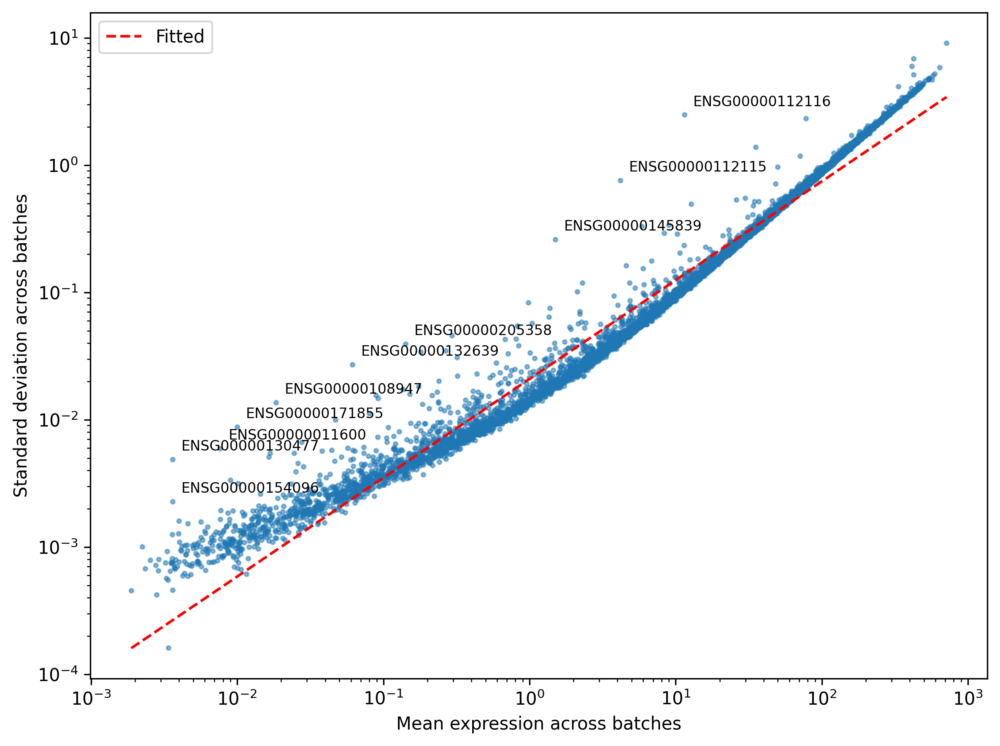

In [10]:
# Calculate mean and standard deviation across batches
mean_values = base_mean_stim.mean(1)
std_values = base_mean_stim.std(1)

# Plot all points
plt.figure(figsize=(8, 6))
plt.scatter(mean_values, std_values, alpha=0.5, s=5)

# Fit a power law relationship between mean and std (std ~ mean^alpha)
# Use log-log space for linear fitting
valid_points = (mean_values > 0) & (std_values > 0)
log_mean = np.log(mean_values[valid_points])
log_std = np.log(std_values[valid_points])
fit = np.polyfit(log_mean, log_std, 1)
alpha = fit[0]  # Power law exponent
const = np.exp(fit[1])  # Multiplicative constant

# Generate fitted line
x_range = np.logspace(np.log10(mean_values.min()), np.log10(mean_values.max()), 100)
fitted_std = const * (x_range ** alpha)
plt.plot(x_range, fitted_std, 'r--', 
         label=f'Fitted')

# Identify outliers based on fitted relationship
expected_std = const * (mean_values ** alpha)
outliers = std_values > (expected_std * 2)  # Points with std > 2x expected
outlier_indices = np.where(outliers)[0]

# Annotate top 10 outliers
if len(outlier_indices) > 0:
    # Sort outliers by deviation from expected
    deviation = std_values[outliers] / expected_std[outliers]
    top_outliers = outlier_indices[np.argsort(deviation)[-10:]]
    
    for idx in top_outliers:
        gene_name = base_mean_stim.index[idx]
        plt.annotate(gene_name, 
                    (mean_values.iloc[idx], std_values.iloc[idx]),
                    xytext=(5, 5), textcoords='offset points',
                    fontsize=8)

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Mean expression across batches')
plt.ylabel('Standard deviation across batches')
plt.legend()
plt.tight_layout()


In [16]:
adata_de.var.iloc[pd.Series(np.where(np.isnan(adata_de.layers['adj_p_value']))[1]).value_counts().index][0:20]

,gene_ids,gene_name,n_signif_effects_Stim8hr,n_signif_effects_Rest
ENSG00000183542,ENSG00000183542,KLRC4,0,0
ENSG00000205810,ENSG00000205810,KLRC3,0,0
ENSG00000112116,ENSG00000112116,IL17F,0,1
ENSG00000232237,ENSG00000232237,ASCL5,0,0
ENSG00000178233,ENSG00000178233,TMEM151B,0,0
ENSG00000120149,ENSG00000120149,MSX2,0,0
ENSG00000160180,ENSG00000160180,TFF3,0,0
ENSG00000104804,ENSG00000104804,TULP2,0,0
ENSG00000274736,ENSG00000274736,CCL23,0,0
ENSG00000227234,ENSG00000227234,SPANXB1,0,0


In [11]:
adata_de.var['mean_baseMean_Rest'] = base_mean_rest.mean(1)
adata_de.var['std_baseMean_Rest'] = base_mean_rest.std(1)

adata_de.var['mean_baseMean_Stim8hr'] = base_mean_stim.mean(1)
adata_de.var['std_baseMean_Stim8hr'] = base_mean_stim.std(1)

### Compare estimates of confounder effects 

In [18]:
de_results_dir = '/mnt/oak/users/emma/data/GWT/CRiCD4_Run1_Illumina/DE_results_all_confounders/tmp/'
de_results_files = glob.glob(de_results_dir + 'DE_results_confounders*.csv.gz')

# Create empty list to store dataframes
dfs = []

# Read and process each file
for file in tqdm(de_results_files, desc="Processing DE result files"):
    df = pd.read_csv(file, compression='gzip', index_col=0)
    df['chunk'] = file.split('.chunk_')[1].split('.')[0]
    df['condition'] = file.split('.')[1]
    dfs.append(df)

# Concatenate all dataframes into one
all_de_results = pd.concat(dfs, axis=0)

Processing DE result files: 100%|██████████| 130/130 [00:09<00:00, 13.95it/s]


/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


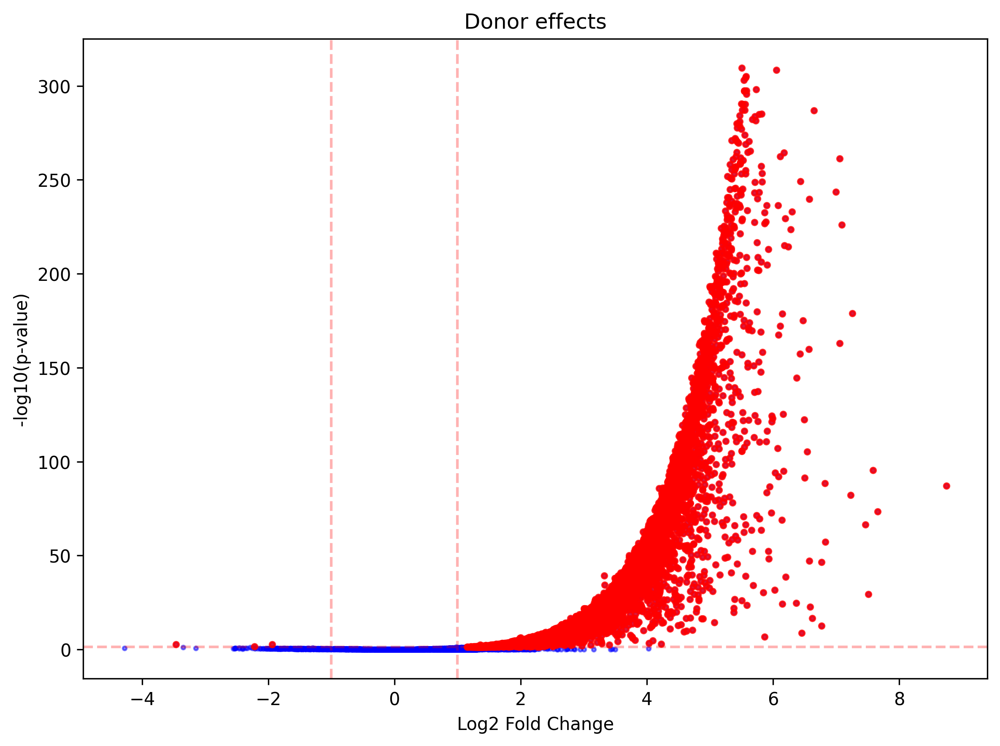

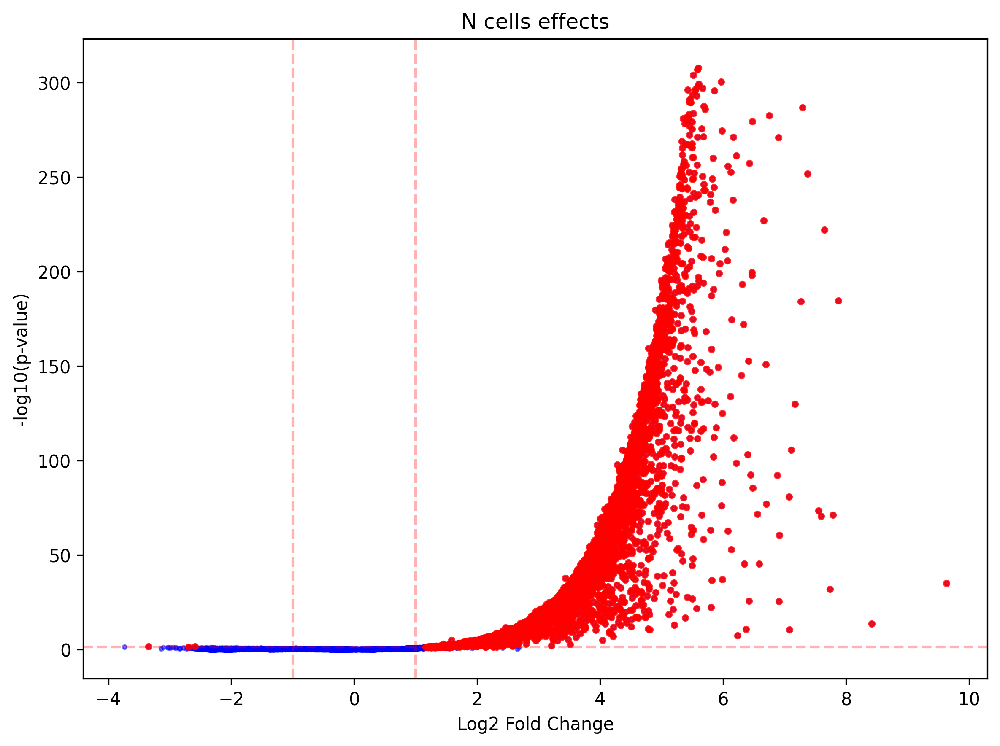

In [19]:
# Create a volcano plot for non-cell-count effects
plt.figure(figsize=(8, 6))
non_count_effects = all_de_results[(all_de_results.contrast != 'log10_n_cells') & (all_de_results.chunk == '0')]
plt.scatter(non_count_effects['log_fc'], -np.log10(non_count_effects['p_value']), 
            alpha=0.5, s=5, color='blue')

# Add threshold lines
plt.axhline(y=-np.log10(0.05), color='red', linestyle='--', alpha=0.3)
plt.axvline(x=-1, color='red', linestyle='--', alpha=0.3)
plt.axvline(x=1, color='red', linestyle='--', alpha=0.3)

# Highlight significant points
significant = (non_count_effects['p_value'] < 0.05) & (abs(non_count_effects['log_fc']) > 1)
plt.scatter(non_count_effects.loc[significant, 'log_fc'], 
            -np.log10(non_count_effects.loc[significant, 'p_value']),
            alpha=0.8, s=10, color='red')

plt.xlabel('Log2 Fold Change')
plt.ylabel('-log10(p-value)')
plt.title('Donor effects')
plt.tight_layout()
plt.show()


# Create a volcano plot for non-cell-count effects
plt.figure(figsize=(8, 6))
non_count_effects = all_de_results[(all_de_results.contrast == 'log10_n_cells') & (all_de_results.chunk == '0')]
plt.scatter(non_count_effects['log_fc'], -np.log10(non_count_effects['p_value']), 
            alpha=0.5, s=5, color='blue')

# Add threshold lines
plt.axhline(y=-np.log10(0.05), color='red', linestyle='--', alpha=0.3)
plt.axvline(x=-1, color='red', linestyle='--', alpha=0.3)
plt.axvline(x=1, color='red', linestyle='--', alpha=0.3)

# Highlight significant points
significant = (non_count_effects['p_value'] < 0.05) & (abs(non_count_effects['log_fc']) > 1)
plt.scatter(non_count_effects.loc[significant, 'log_fc'], 
            -np.log10(non_count_effects.loc[significant, 'p_value']),
            alpha=0.8, s=10, color='red')

plt.xlabel('Log2 Fold Change')
plt.ylabel('-log10(p-value)')
plt.title('N cells effects')
plt.tight_layout()
plt.show()


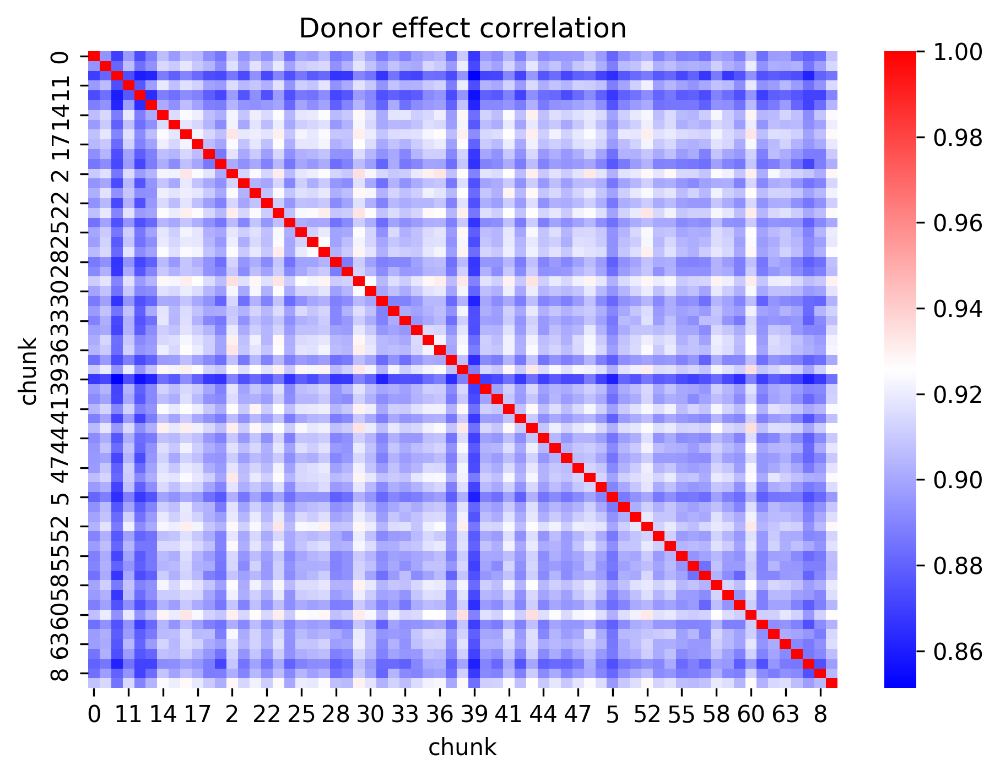

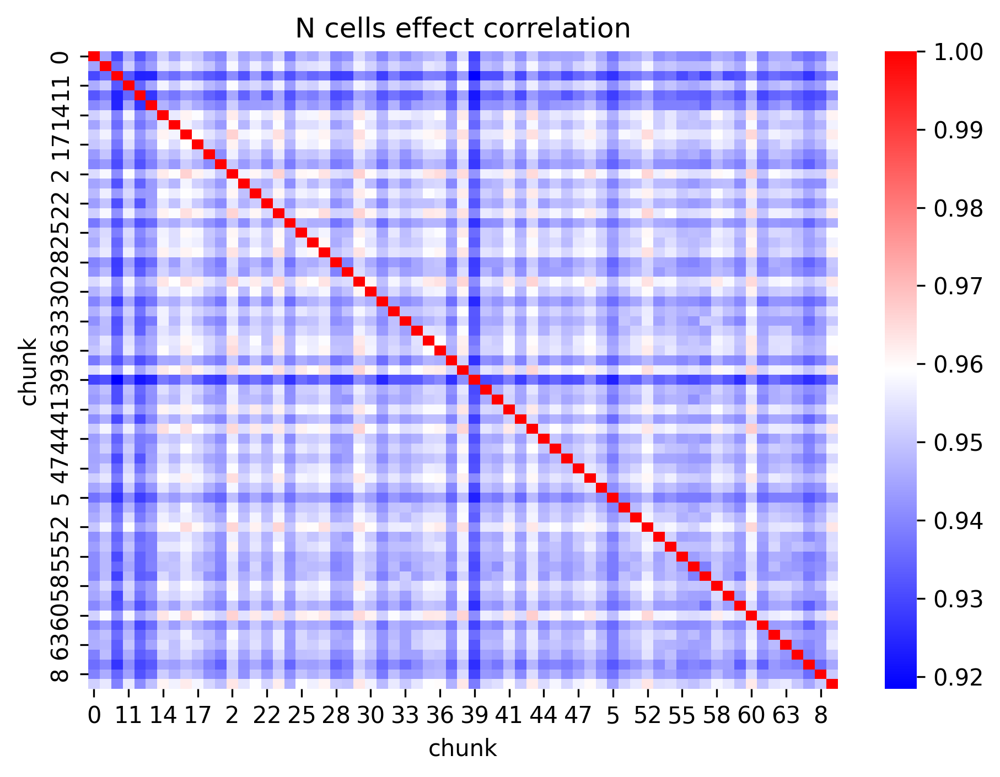

In [20]:
donor_effects = all_de_results[all_de_results.contrast != 'log10_n_cells'].pivot(index=['variable', 'condition'], columns='chunk', values='log_fc').dropna()
sns.heatmap(donor_effects.corr(), cmap='bwr')
plt.title("Donor effect correlation");
plt.show()

count_effects = all_de_results[all_de_results.contrast == 'log10_n_cells'].pivot(index=['variable', 'condition'], columns='chunk', values='log_fc').dropna()
sns.heatmap(count_effects.corr(), cmap='bwr')
plt.title("N cells effect correlation");
plt.show()

## Power on lowly-expressed genes

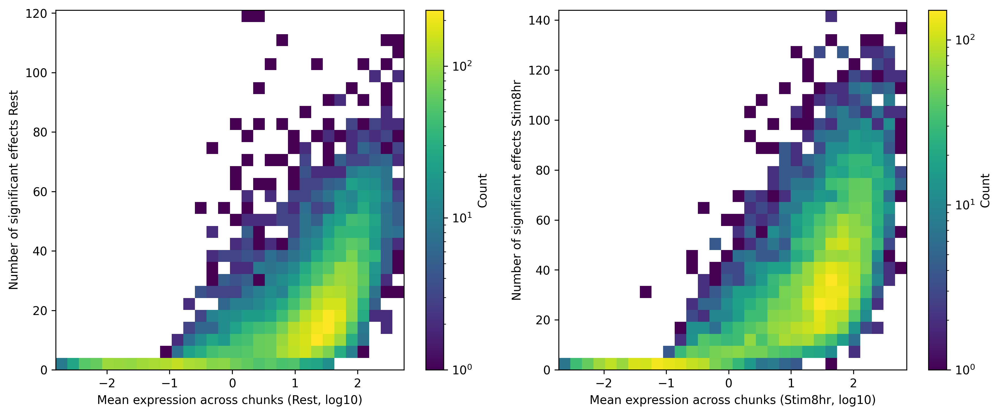

In [21]:
plt.figure(figsize=(12,5))
for i,cond in enumerate(['Rest', 'Stim8hr']):
    plt.subplot(1,2,i+1)
    plt.hist2d(
        np.log10(adata_de.var[f'mean_baseMean_{cond}']), 
        adata_de.var[f'n_signif_effects_{cond}'],
        bins=30, 
        norm=matplotlib.colors.LogNorm()
    )
    plt.colorbar(label='Count')
    # plt.xscale('log')
    plt.xlabel(f'Mean expression across chunks ({cond}, log10)')
    plt.ylabel(f'Number of significant effects {cond}')
plt.tight_layout()


Text(0, 0.5, 'Mean baseMean Rest')

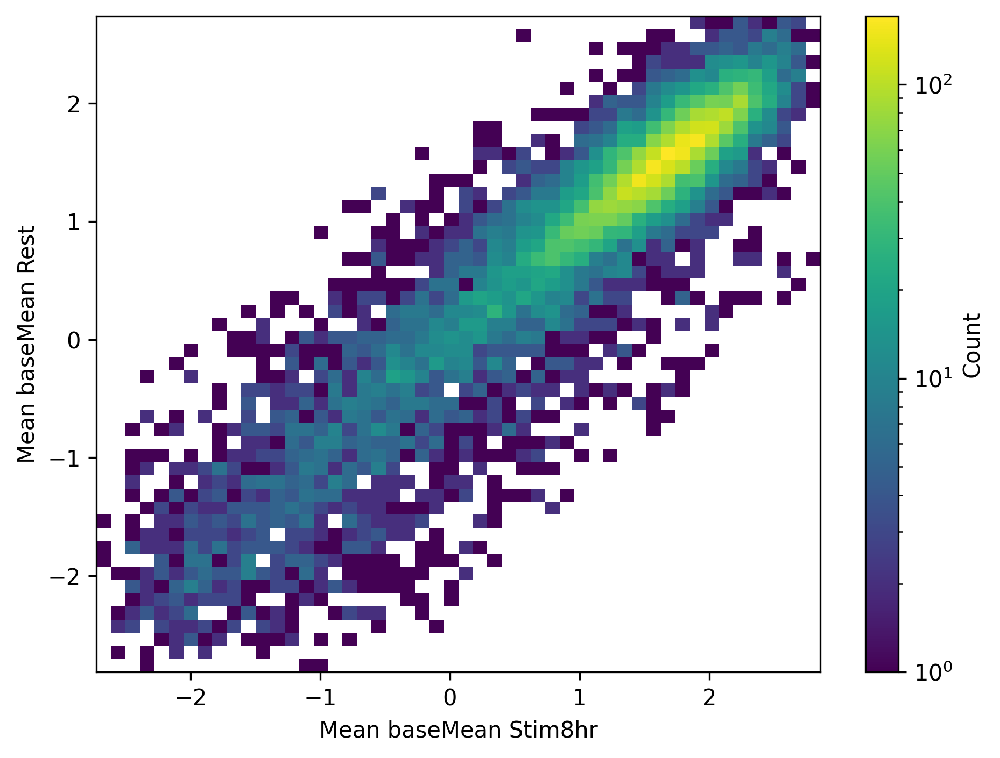

In [22]:
plt.hist2d(
    np.log10(adata_de.var['mean_baseMean_Stim8hr']), 
    np.log10(adata_de.var['mean_baseMean_Rest']), 
    bins=50, 
    norm=matplotlib.colors.LogNorm()
)
plt.colorbar(label='Count')
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel('Mean baseMean Stim8hr')
plt.ylabel('Mean baseMean Rest')

In [12]:
# Exclude from analysis genes with very low base mean across conditions
gs_mask = (adata_de.var['mean_baseMean_Stim8hr'] > 0.1) & (adata_de.var['mean_baseMean_Rest'] > 0.1) 
sum(~gs_mask)

947

In [13]:
sum(gs_mask)

9132

In [14]:
adata_de = adata_de[:, gs_mask].copy()

In [26]:
adata_de

AnnData object with n_obs × n_vars = 17528 × 9132
    obs: 'target_contrast_gene_name', 'culture_condition', 'target_contrast', 'chunk', 'n_cells_target'
    var: 'gene_ids', 'gene_name', 'n_signif_effects_Stim8hr', 'n_signif_effects_Rest', 'mean_baseMean_Rest', 'std_baseMean_Rest', 'mean_baseMean_Stim8hr', 'std_baseMean_Stim8hr'
    layers: 'adj_p_value', 'baseMean', 'lfcSE', 'log_fc', 'p_value', 'zscore'

## On-target effect

In [15]:
adata_de.var_names = adata_de.var['gene_ids'].values

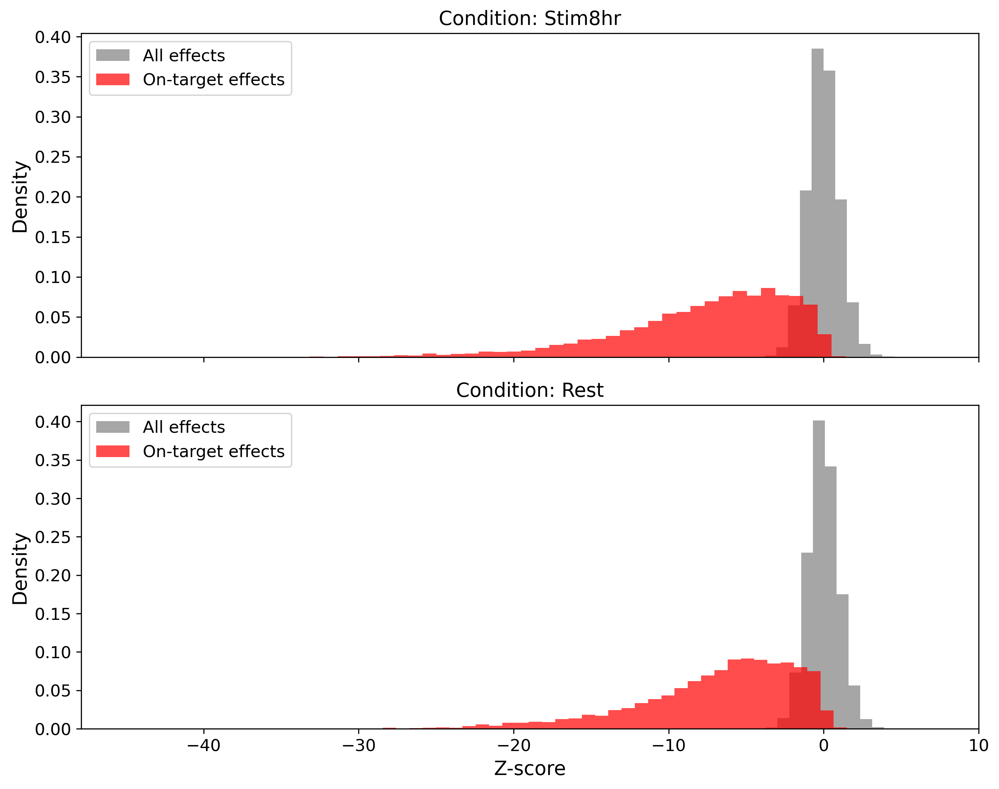

In [28]:
# Get all unique culture conditions
conditions = adata_de.obs['culture_condition'].unique()

# Create a figure with subplots, one for each condition
fig, axes = plt.subplots(len(conditions), 1, figsize=(10, 4*len(conditions)), sharex=True)

for i, cond in enumerate(conditions):
    all_targets = adata_de[adata_de.obs['culture_condition'] == cond].obs['target_contrast'].astype(str).unique()
    measured_targets = adata_de.var_names[adata_de.var_names.isin(all_targets)].tolist()
    measured_targets_names = adata_de.var['gene_name'][adata_de.var_names.isin(all_targets)].tolist()
    # Get on-target effects for this condition
    ontarget_cond = sc.get.obs_df(adata_de[adata_de.obs['culture_condition'] == cond], 
                                  ['target_contrast'] + measured_targets, layer='zscore')
    ontarget_cond = ontarget_cond.set_index('target_contrast').loc[measured_targets]
    
    # Plot histograms with normalized heights (density=True)
    axes[i].hist(adata_de[adata_de.obs['culture_condition'] == cond].layers['zscore'].flatten(), 
                bins=100, density=True, alpha=0.7, color='grey', label='All effects')
    axes[i].hist(np.diag(ontarget_cond.values), bins=50, density=True, alpha=0.7, 
                color='red', label='On-target effects')
    
    axes[i].set_ylabel('Density', fontsize=14)
    axes[i].tick_params(labelsize=12)
    axes[i].legend(fontsize=12)
    axes[i].set_title(f'Condition: {cond}', fontsize=14)
    axes[i].set_xlim(right=10)  # Set upper x-limit to 10

# Set common x-label
plt.xlabel('Z-score', fontsize=14)
plt.tight_layout()


In [29]:
# # Get all unique culture conditions
# conditions = adata_de.obs['culture_condition'].unique()

# # Create a figure with subplots, one for each condition
# fig, axes = plt.subplots(len(conditions), 1, figsize=(10, 4*len(conditions)), sharex=True)

# for i, cond in enumerate(conditions):
#     # Get on-target effects for this condition
#     ontarget_cond = sc.get.obs_df(adata_de[adata_de.obs['culture_condition'] == cond], 
#                                   ['target_contrast'] + measured_targets, layer='MASH_PosteriorMean')
#     ontarget_cond = ontarget_cond.set_index('target_contrast').loc[measured_targets]
    
#     # Plot histograms with normalized heights (density=True)
#     axes[i].hist(adata_de[adata_de.obs['culture_condition'] == cond].layers['MASH_PosteriorMean'].flatten(), 
#                 bins=100, density=True, alpha=0.7, color='grey', label='All effects')
#     axes[i].hist(np.diag(ontarget_cond.values), bins=50, density=True, alpha=0.7, 
#                 color='red', label='On-target effects')
    
#     axes[i].set_ylabel('Density', fontsize=14)
#     axes[i].tick_params(labelsize=12)
#     axes[i].legend(fontsize=12)
#     axes[i].set_title(f'Condition: {cond}', fontsize=14)
#     axes[i].set_xlim(right=10)  # Set upper x-limit to 10

# # Set common x-label
# plt.xlabel('MASH Posterior', fontsize=14)
# plt.tight_layout()


Compare DESeq2 estimates with knock-down efficiency estimated with t-test

In [30]:
adata_de

AnnData object with n_obs × n_vars = 17528 × 9132
    obs: 'target_contrast_gene_name', 'culture_condition', 'target_contrast', 'chunk', 'n_cells_target'
    var: 'gene_ids', 'gene_name', 'n_signif_effects_Stim8hr', 'n_signif_effects_Rest', 'mean_baseMean_Rest', 'std_baseMean_Rest', 'mean_baseMean_Stim8hr', 'std_baseMean_Stim8hr'
    layers: 'adj_p_value', 'baseMean', 'lfcSE', 'log_fc', 'p_value', 'zscore'

In [16]:
adata_de.var_names = adata_de.var['gene_ids'].values

In [32]:
ontarget_df = pd.DataFrame()
for culture_condition in conditions:
    # Get on-target effects for this condition
    ontarget_df_c = get_ontarget_effect(
            adata_de[adata_de.obs['culture_condition'] == culture_condition], 
            signif_estimate='adj_p_value',
            signif_alpha=0.1
        )
    ontarget_df_c['culture_condition'] = culture_condition
    ontarget_df = pd.concat([ontarget_df, ontarget_df_c])

In [33]:
ontarget_df.significant.sum()/ontarget_df.shape[0]

0.6644990710304416

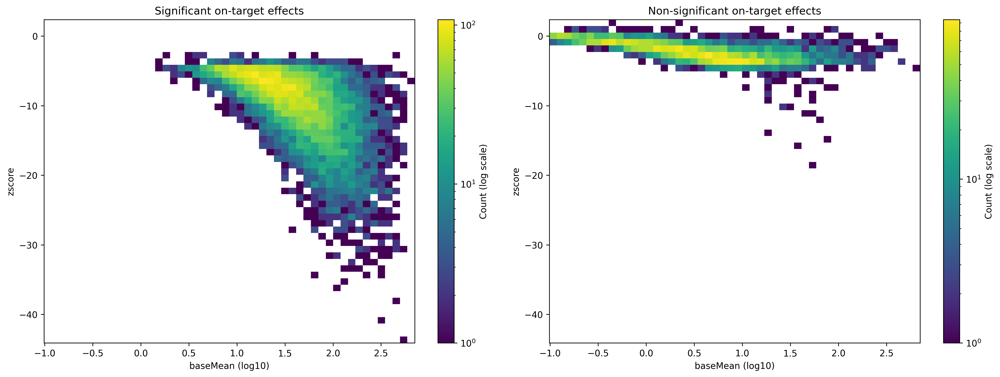

In [34]:
# Create two 2D histograms side by side for significant and non-significant effects
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Calculate global min/max for x and y axes
x_min = np.log10(ontarget_df['baseMean'].min())
x_max = np.log10(ontarget_df['baseMean'].max())
y_min = ontarget_df['zscore'].min()
y_max = ontarget_df['zscore'].max()

# Plot significant effects
h1 = ax1.hist2d(
    np.log10(ontarget_df[ontarget_df['significant']]['baseMean']), 
    ontarget_df[ontarget_df['significant']]['zscore'],
    bins=50, 
    norm=matplotlib.colors.LogNorm(),
    cmap='viridis',
    range=[[x_min, x_max], [y_min, y_max]]
)
plt.colorbar(h1[3], ax=ax1, label='Count (log scale)')
ax1.set_xlabel('baseMean (log10)')
ax1.set_ylabel('zscore')
ax1.set_title('Significant on-target effects')

# Plot non-significant effects
h2 = ax2.hist2d(
    np.log10(ontarget_df[~ontarget_df['significant']]['baseMean']), 
    ontarget_df[~ontarget_df['significant']]['zscore'],
    bins=50, 
    norm=matplotlib.colors.LogNorm(),
    cmap='viridis',
    range=[[x_min, x_max], [y_min, y_max]]
)
plt.colorbar(h2[3], ax=ax2, label='Count (log scale)')
ax2.set_xlabel('baseMean (log10)')
ax2.set_ylabel('zscore')
ax2.set_title('Non-significant on-target effects')

plt.tight_layout()

<Axes: xlabel='zscore', ylabel='min_effect_size'>

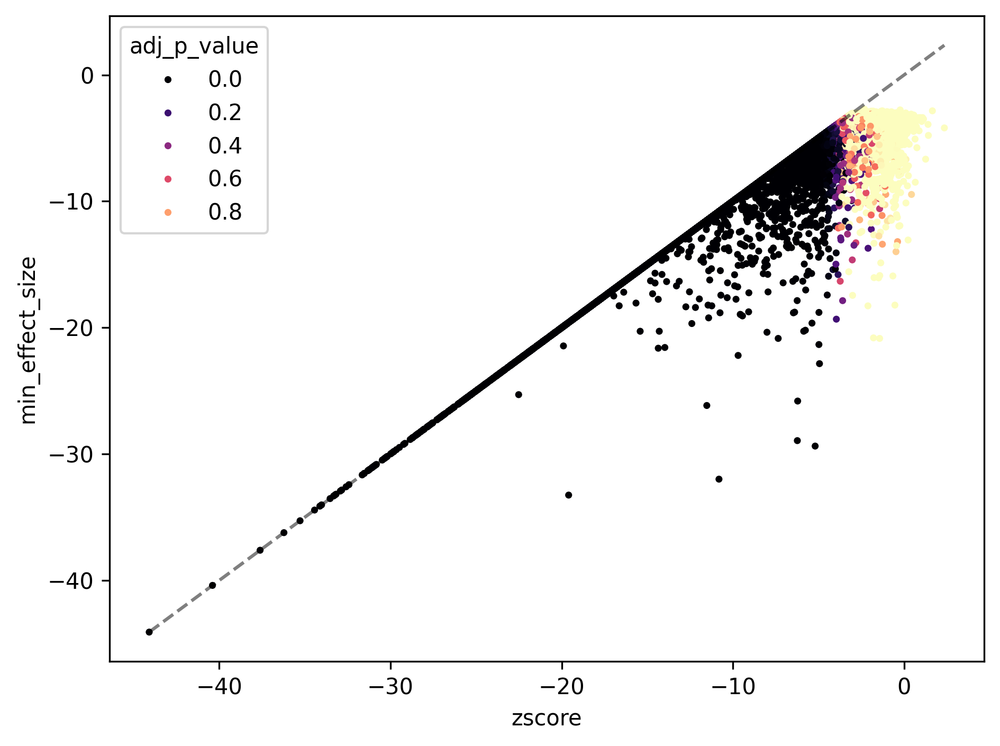

In [35]:
min_effect_gene = adata_de.var.iloc[np.argmin(adata_de.layers['zscore'], axis=1)]['gene_name']
min_effect_size = np.min(adata_de.layers['zscore'], axis=1)
min_effect_df = pd.DataFrame(np.column_stack([adata_de.obs['culture_condition'].values, adata_de.obs['target_contrast'].values, min_effect_gene.values, min_effect_size]), 
             columns=['culture_condition','target_contrast','min_effect_gene', 'min_effect_size'])

pl_df = pd.merge(ontarget_df, min_effect_df)

# Add diagonal line first so it appears under the points
x_min = pl_df['zscore'].min()
x_max = pl_df['zscore'].max()
plt.plot([x_min, x_max], [x_min, x_max], 'k--', alpha=0.5)

# Plot the scatter with magma color scale
sns.scatterplot(data=pl_df, x='zscore', y='min_effect_size', 
                hue='adj_p_value', s=10, linewidth=0, palette='magma')

In [36]:
# min_effect_gene = adata_de.var.iloc[np.argmin(adata_de.layers['MASH_PosteriorMean'], axis=1)]['gene_name']
# min_effect_size = np.min(adata_de.layers['MASH_PosteriorMean'], axis=1)
# min_effect_df = pd.DataFrame(np.column_stack([adata_de.obs['culture_condition'].values, adata_de.obs['target_contrast'].values, min_effect_gene.values, min_effect_size]), 
#              columns=['culture_condition','target_contrast','min_effect_gene', 'min_effect_size'])

# pl_df = pd.merge(ontarget_df, min_effect_df)

# # Add diagonal line first so it appears under the points
# x_min = pl_df['MASH_PosteriorMean'].min()
# x_max = pl_df['MASH_PosteriorMean'].max()
# plt.plot([x_min, x_max], [x_min, x_max], 'k--', alpha=0.5)

# # Plot the scatter with magma color scale
# sns.scatterplot(data=pl_df, x='MASH_PosteriorMean', y='min_effect_size', 
#                 hue='MASH_lfsr', s=10, linewidth=0, palette='magma');
# plt.xlabel('On-target effect size\n(MASH posterior mean)');
# plt.ylabel('Smallest effect size\n(MASH posterior mean)')

### Evidence for off-target in close genes

In [37]:
# Read gene annotations
import genomic_features as gf
ensdb = gf.ensembl.annotation(species="Hsapiens", version="108")
genes = ensdb.genes()
genes_coords = genes.set_index('gene_id').loc[adata_de.var['gene_ids']][['seq_name', 'gene_seq_start', 'gene_seq_end', 'seq_strand']]

In [38]:
import bioframe as bf
import pandas as pd
import numpy as np

def find_closest_genes_by_tss(target_ids, gene_coordinates, k=3):
    """
    Find the k closest genes for each target gene ID based on 
    transcription start site (TSS) distance.
    
    Parameters:
    -----------
    target_ids : list
        List of Ensembl IDs for target genes
    gene_coordinates : pandas.DataFrame
        DataFrame containing gene coordinates with Ensembl IDs as index
    k : int
        Number of closest genes to find (default: 3)
        
    Returns:
    --------
    pandas.DataFrame
        DataFrame with target genes and their k closest genes
    """
    # Convert genes_coords to bioframe-compatible format with TSS
    genes_df = gene_coordinates.reset_index().copy()
    
    # Calculate TSS for each gene (accounting for strand if available)
    if 'seq_strand' in genes_df.columns:
        # If strand information is available, use it to determine TSS
        genes_df['tss'] = genes_df.apply(
            lambda x: x['gene_seq_start'] if x['seq_strand'] == 1 else x['gene_seq_end'], 
            axis=1
        )
    else:
        # If no strand info, assume all genes are on + strand
        genes_df['tss'] = genes_df['gene_seq_start']
    
    # Create bioframe-compatible dataframe with TSS as both start and end
    # This represents the TSS as a single point
    tss_df = genes_df.rename(
        columns={'gene_id': 'name', 'seq_name': 'chrom'}
    )
    tss_df['start'] = tss_df['tss']
    tss_df['end'] = tss_df['tss'] + 1  # Add 1 to make a 1bp interval
    
    # Create a subset for targets
    targets_tss_df = tss_df[tss_df['name'].isin(target_ids)].copy()
    
    if targets_tss_df.empty:
        raise ValueError("None of the target IDs were found in the gene coordinates dataframe")
    
    # Create a dictionary to store results
    results = []
    
    # Find closest genes for each target
    for _, target in targets_tss_df.iterrows():
        # Create a single-row DataFrame for the current target
        target_region = pd.DataFrame([{
            'chrom': target['chrom'],
            'start': target['start'],
            'end': target['end'],
            'name': target['name']
        }])
        
        # Remove the current target from the genes dataframe to avoid self-matches
        other_genes_tss = tss_df[tss_df['name'] != target['name']].copy()
        other_genes_tss = other_genes_tss[['chrom', 'start', 'end', 'name']]
        
        # Find k closest genes based on TSS with explicit suffixes
        closest = bf.closest(
            target_region,
            other_genes_tss,
            k=k,
            ignore_overlaps=False,
            suffixes=('_target', '_closest')  # Explicitly define suffixes
        )
        
        # Extract relevant information using the new suffix names
        for i in range(min(k, len(closest))):
            closest_gene = closest.iloc[i]
            results.append({
                'target_id': target['name'],
                'target_chrom': target['chrom'],
                'target_tss': target['tss'],
                'rank': i + 1,
                'closest_id': closest_gene['name_closest'],
                'closest_chrom': closest_gene['chrom_closest'],
                'closest_tss': closest_gene['start_closest'],
                'distance': closest_gene['distance']
            })
    
    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    
    return results_df

# Usage:
closest_genes_by_tss = find_closest_genes_by_tss(ontarget_df.target_contrast.unique(), genes_coords)

In [39]:
closest_id = closest_genes_by_tss.pivot(index='target_id', columns='rank', values='closest_id')
closest_dist = closest_genes_by_tss.pivot(index='target_id', columns='rank', values='distance')

closest_genes_by_tss = closest_genes_by_tss.rename({'closest_id':'gene_ids'}, axis=1)

In [40]:
all_closest_genes_effect = pd.DataFrame()

from tqdm.notebook import tqdm
for t in tqdm(ontarget_df.target_contrast.unique(), desc="Processing targets"):
    # Get DE results for closest genes to this target
    closest_genes_effect = get_DE_results_long(
        adata_de,
        targets=[t], genes=closest_id.loc[t], 
        effect_estimates = ['zscore'],
        signif_estimate = 'adj_p_value',
        target_id_col = 'target_contrast',
        gene_id_col='gene_ids'
    )
    
    # Get distance information for this target
    dist_df = closest_genes_by_tss[closest_genes_by_tss.target_id == t][['gene_ids', 'rank', 'distance']]
    
    # Merge distance information with DE results
    closest_genes_effect = pd.merge(closest_genes_effect, dist_df)
    
    # Concatenate to main results dataframe
    all_closest_genes_effect = pd.concat([all_closest_genes_effect, closest_genes_effect])

# Add on-target effects
# all_ontarget_effect = ontarget_df[ontarget_df.target_contrast.isin(measured_targets)].copy()
all_ontarget_effect = ontarget_df.copy()
all_ontarget_effect['distance'] = 0
all_ontarget_effect['rank'] = 0
all_ontarget_effect = pd.concat([all_ontarget_effect, all_closest_genes_effect]).sort_values(['target_contrast', 'rank'])

Processing targets:   0%|          | 0/7222 [00:00<?, ?it/s]

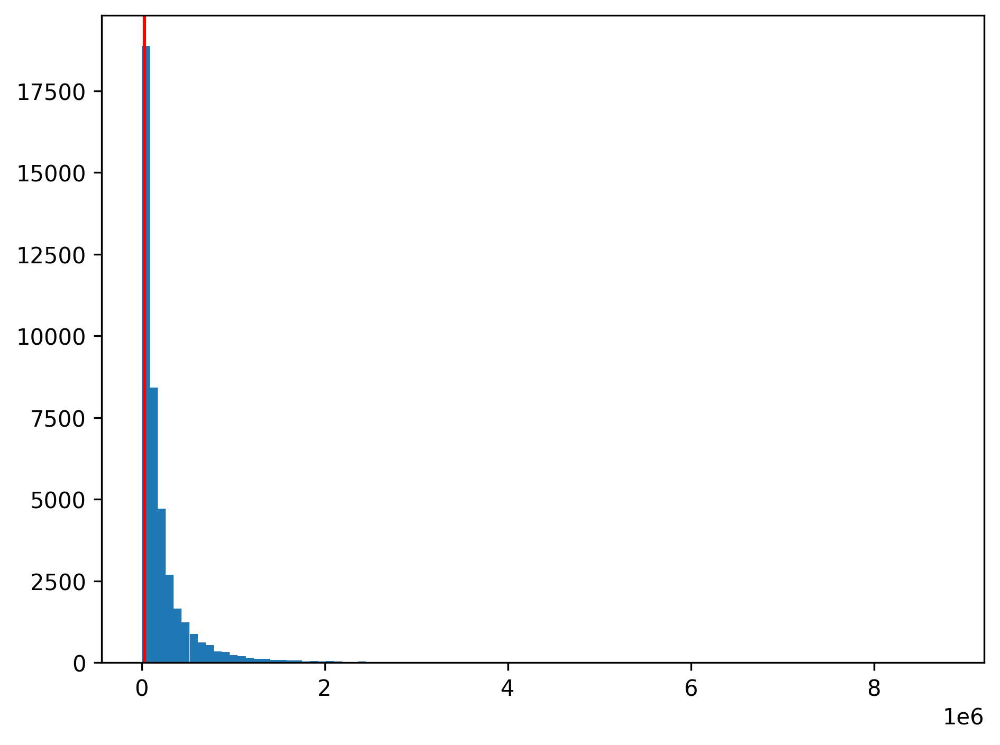

In [41]:
plt.hist(all_ontarget_effect[all_ontarget_effect['rank'] > 0].distance, bins=100);
plt.axvline(30000, color='red')
all_ontarget_effect_close = all_ontarget_effect[all_ontarget_effect.distance < 30000]

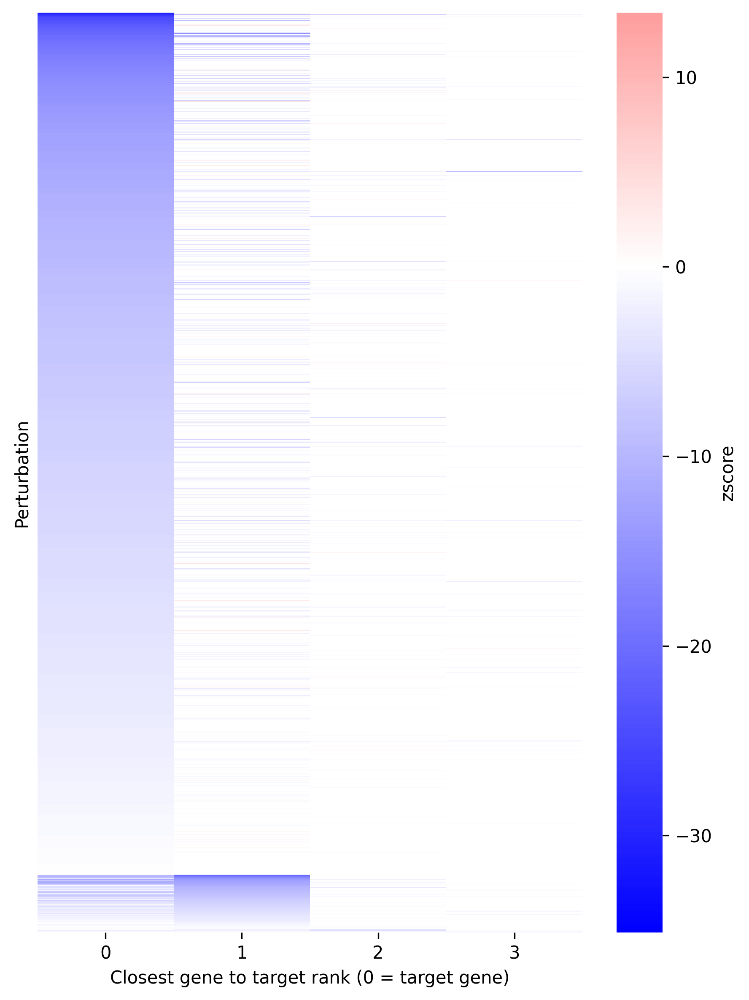

In [42]:
# Pivot the data to create a matrix suitable for heatmap
heatmap_data = all_ontarget_effect_close.pivot_table(
    values='zscore', 
    index='target_contrast', 
    columns='rank', 
    aggfunc='mean'
)

# First sort by the rank with the minimum effect size, then within each rank group sort by effect size
min_rank_per_target = heatmap_data.idxmin(axis=1)
sorted_targets = []
for rank in sorted(min_rank_per_target.unique()):
    # Get targets with minimum effect at this rank
    targets_with_min_at_rank = min_rank_per_target[min_rank_per_target == rank].index
    # Sort these targets by their effect size at this rank
    sorted_by_effect = heatmap_data.loc[targets_with_min_at_rank, rank].sort_values().index
    sorted_targets.extend(sorted_by_effect)
heatmap_data = heatmap_data.loc[sorted_targets]

plt.figure(figsize=(6, 8))
ax = sns.heatmap(heatmap_data, cbar_kws={'label': 'zscore'}, center=0, cmap='bwr')
# plt.title('Effect size (MASH_PosteriorMean) by distance rank from target gene')
plt.xlabel('Closest gene to target rank (0 = target gene)')
plt.ylabel('Perturbation')
# Hide y-axis labels as requested
ax.set_yticks([])
plt.tight_layout()

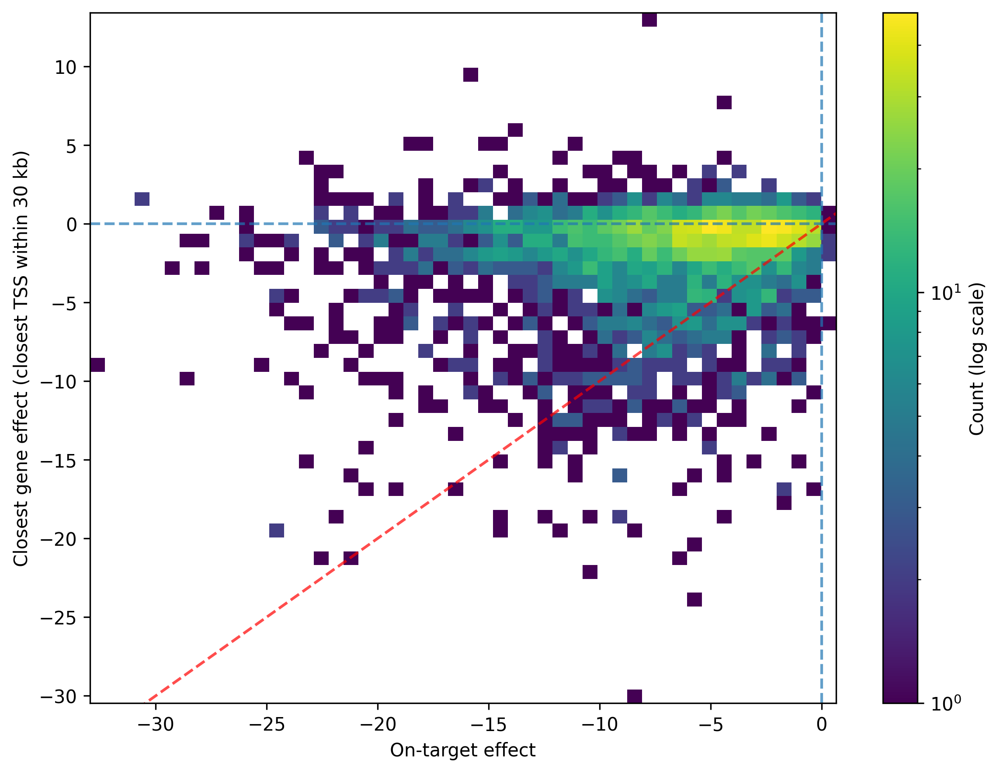

In [43]:
# Pivot the data to create a matrix suitable for heatmap
heatmap_data = all_ontarget_effect_close.pivot_table(
    values='zscore', 
    index='target_contrast', 
    columns='rank', 
    aggfunc='mean'
).iloc[:, 0:2].dropna()

# Create a 2D histogram with logarithmic color scale
plt.figure(figsize=(8, 6))
h = plt.hist2d(heatmap_data[0], heatmap_data[1], bins=50, 
               norm=matplotlib.colors.LogNorm(), cmap='viridis')
plt.colorbar(h[3], label='Count (log scale)')
plt.xlabel('On-target effect')
plt.ylabel('Closest gene effect (closest TSS within 30 kb)')

# Add diagonal line
min_val = min(heatmap_data[0].min(), heatmap_data[1].min())
max_val = max(heatmap_data[0].max(), heatmap_data[1].max())
plt.plot([min_val, max_val], [min_val, max_val], 'r--', alpha=0.7, label='y=x')
# plt.legend()
plt.axhline(0, linestyle='--', alpha=0.7)
plt.axvline(0, linestyle='--', alpha=0.7)

/tmp/ipykernel_2797673/3330957835.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  all_ontarget_effect_close['putative_offtarget'] = all_ontarget_effect_close.target_contrast.isin(min_rank_per_target.index[(min_rank_per_target==1) & (heatmap_data[1] < -0.1)])
/tmp/ipykernel_2797673/3330957835.py:2: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(data=all_ontarget_effect_close, x='rank', y='zscore', scale='width', cut=0, hue='putative_offtarget')


<Axes: xlabel='rank', ylabel='zscore'>

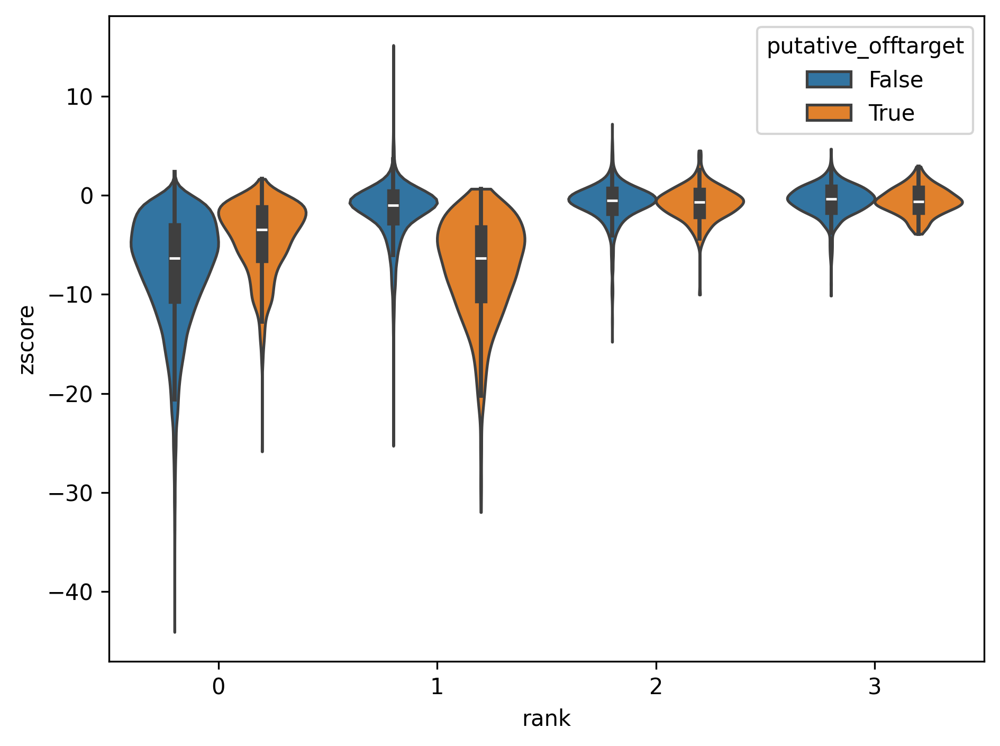

In [44]:
all_ontarget_effect_close['putative_offtarget'] = all_ontarget_effect_close.target_contrast.isin(min_rank_per_target.index[(min_rank_per_target==1) & (heatmap_data[1] < -0.1)])
sns.violinplot(data=all_ontarget_effect_close, x='rank', y='zscore', scale='width', cut=0, hue='putative_offtarget')

/tmp/ipykernel_2797673/2128708139.py:4: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(data=pl_df, x='putative_offtarget', y='distance', hue='putative_offtarget', cut=0, scale='width');


Text(0, 0.5, 'TSS distance to\nclosest gene (bp)')

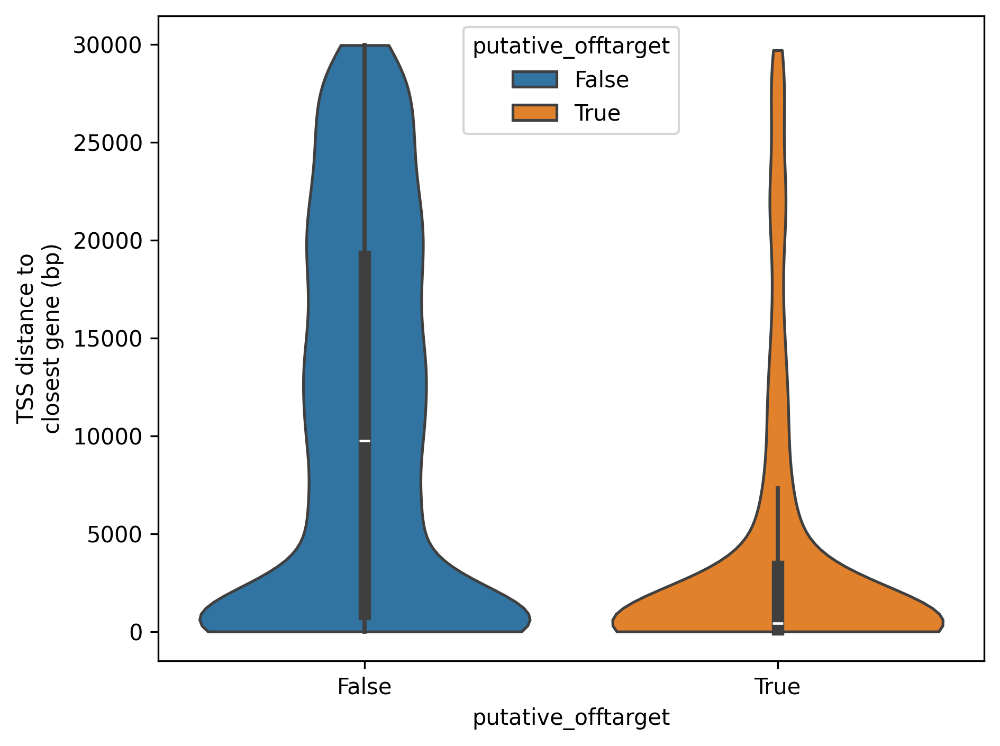

In [45]:
pl_df = all_ontarget_effect_close.copy()
pl_df['distance'] = np.where(pl_df.distance == 0, 0.1, pl_df.distance)
pl_df = pl_df[pl_df['rank'] == 1]
sns.violinplot(data=pl_df, x='putative_offtarget', y='distance', hue='putative_offtarget', cut=0, scale='width');
plt.ylabel('TSS distance to\nclosest gene (bp)')

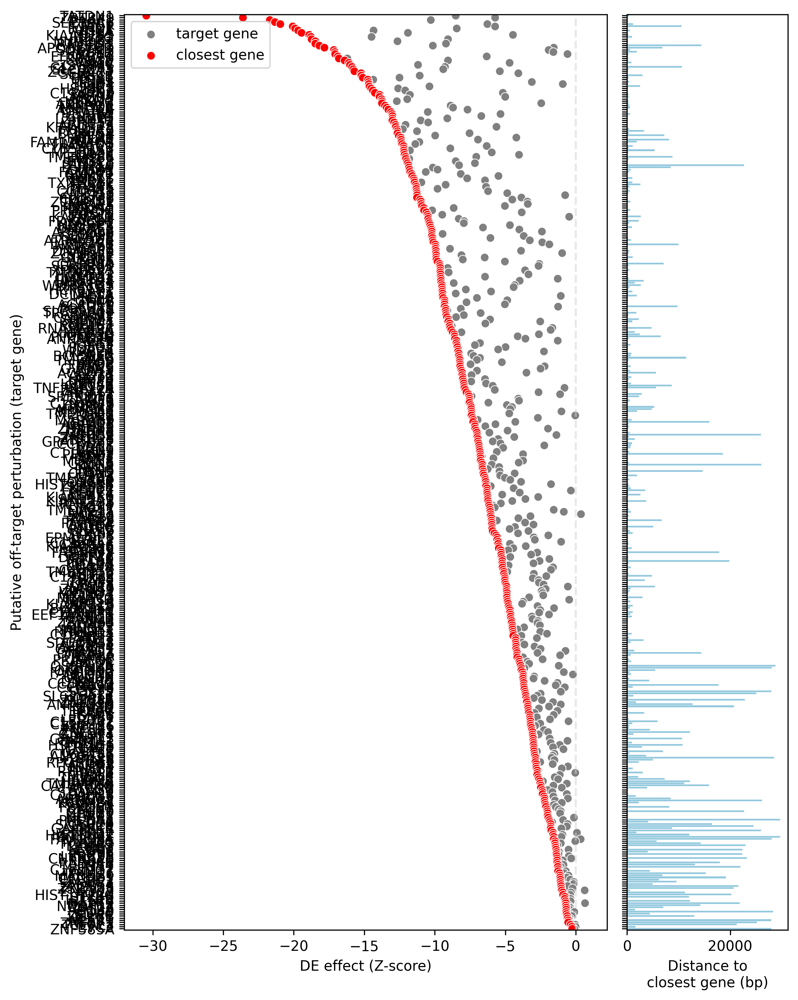

In [46]:
dist_rank1 = all_ontarget_effect_close[all_ontarget_effect_close['putative_offtarget'] & (all_ontarget_effect_close['rank'] == 1)].set_index('target_contrast')['distance']

pl_df = heatmap_data.loc[dist_rank1.index].copy()
# pl_df['distance_rank1'] = 
pl_df['distance_rank1'] = dist_rank1
pl_df = pl_df.reset_index()
pl_df = pl_df.sort_values(1)
pl_df = pd.merge(pl_df, adata_de.obs[['target_contrast', 'target_contrast_gene_name']].drop_duplicates(), how='left')
pl_df['target_contrast_gene_name'] = pl_df['target_contrast_gene_name'].astype(str)

# Create a figure with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,10), gridspec_kw={'width_ratios': [3, 1]}, sharey=True)

# First subplot with scatterplots
sns.scatterplot(data=pl_df, x=0, y='target_contrast_gene_name', color='grey', ax=ax1, label='target gene')
sns.scatterplot(data=pl_df, x=1, y='target_contrast_gene_name', color='red', ax=ax1, label='closest gene')
ax1.legend()
ax1.axvline(0, color='lightgray', linestyle='--', alpha=0.5)
ax1.set_xlabel('DE effect (Z-score)')
ax1.set_ylabel('Putative off-target perturbation (target gene)')

# Second subplot with barplot showing distances
sns.barplot(data=pl_df, x='distance_rank1', y='target_contrast_gene_name', ax=ax2, orient='h', color='skyblue')
ax2.set_xlabel('Distance to\nclosest gene (bp)')
ax2.set_ylabel('')
plt.tight_layout()


In [47]:
# putative_offtargets = all_ontarget_effect_close[all_ontarget_effect_close['putative_offtarget']]['target_contrast'].unique()
# # Create a dictionary mapping target_id to gene_id for putative offtargets
# offtarget_dict = dict(zip(
#     closest_genes_by_tss[closest_genes_by_tss['target_id'].isin(putative_offtargets) & (closest_genes_by_tss['rank'] == 1)]['target_id'],
#     closest_genes_by_tss[closest_genes_by_tss['target_id'].isin(putative_offtargets) & (closest_genes_by_tss['rank'] == 1)]['gene_ids']
# ))
# offtarget_genes = closest_genes_by_tss[closest_genes_by_tss['target_id'].isin(putative_offtargets) & (closest_genes_by_tss['rank'] == 1)]['gene_ids'].unique()

In [48]:
# pairs = [(k,v) for k,v in offtarget_dict.items() if v in measured_targets]
# len(pairs)


In [49]:
# for i,j in pairs[0:5]:
#     try:
#         adata_de.var_names = adata_de.var['gene_name'].values
#         t_name_1 = adata_de.var_names[adata_de.var['gene_ids'] == i][0]
#         t_name_2 = adata_de.var_names[adata_de.var['gene_ids'] == j][0]
#         # t_name='IDH3G'

#         res = plot_effect_comparison(
#             adata_de, 
#             comparison_params = {
#                 'target_contrast_gene_name':[ t_name_1, t_name_2],
#                 'culture_condition':['Stim8hr'],
#                 'stat':['zscore']
#             }
#             )
#     except:
#         continue

Compare effects on all closest genes within a range

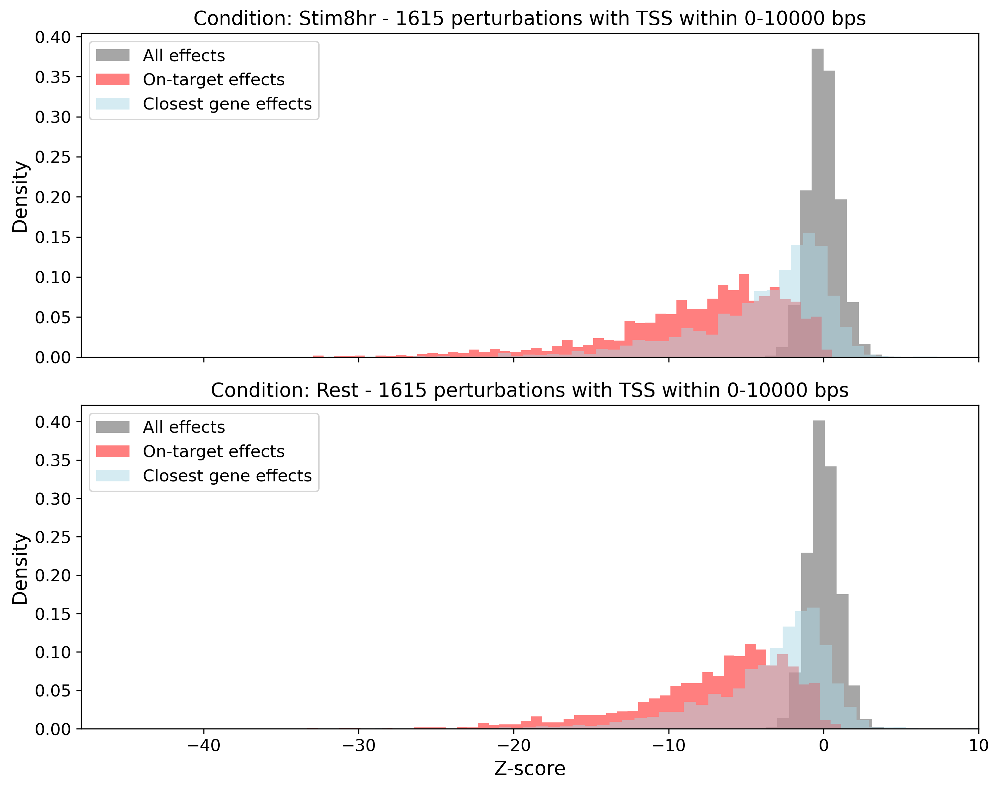

In [50]:
# Get all unique culture conditions
conditions = adata_de.obs['culture_condition'].unique()

min_dist = 0
max_dist = 10000
# Keep targets where the closest gene is between 10kb and 30kb away
keep_targets = all_ontarget_effect[all_ontarget_effect['rank'] == 1][
    (all_ontarget_effect[all_ontarget_effect['rank'] == 1].distance >= min_dist) & 
    (all_ontarget_effect[all_ontarget_effect['rank'] == 1].distance < max_dist)
].target_contrast.unique()
pl_df = all_ontarget_effect[all_ontarget_effect.target_contrast.isin(keep_targets)]
n_perts = pl_df.target_contrast.nunique()
# Create a figure with subplots, one for each condition
fig, axes = plt.subplots(len(conditions), 1, figsize=(10, 4*len(conditions)), sharex=True)

for i, cond in enumerate(conditions):
    axes[i].hist(adata_de[adata_de.obs['culture_condition'] == cond].layers['zscore'].flatten(), 
                bins=100, density=True, alpha=0.7, color='grey', label='All effects')
    # axes[i].hist(all_ontarget_effect[(all_ontarget_effect['rank'] == 0) & (all_ontarget_effect.culture_condition==cond)]['zscore'], bins=50, density=True, alpha=0.7, 
    #             color='red', label='On-target effects')
    axes[i].hist(pl_df[(pl_df['rank'] == 0) & (pl_df.culture_condition==cond)]['zscore'], bins=50, density=True, alpha=0.5, 
                color='red', label='On-target effects');
    axes[i].hist(pl_df[(pl_df['rank'] == 1) & (pl_df.culture_condition==cond)]['zscore'], bins=50, density=True, alpha=0.5, 
                color='lightblue', label=f'Closest gene effects')
    
    axes[i].set_ylabel('Density', fontsize=14)
    axes[i].tick_params(labelsize=12)
    axes[i].legend(fontsize=12)
    axes[i].set_title(f'Condition: {cond} - {n_perts} perturbations with TSS within {min_dist}-{max_dist} bps', fontsize=14)
    axes[i].set_xlim(right=10)  # Set upper x-limit to 10

# Set common x-label
plt.xlabel('Z-score', fontsize=14)
plt.tight_layout()

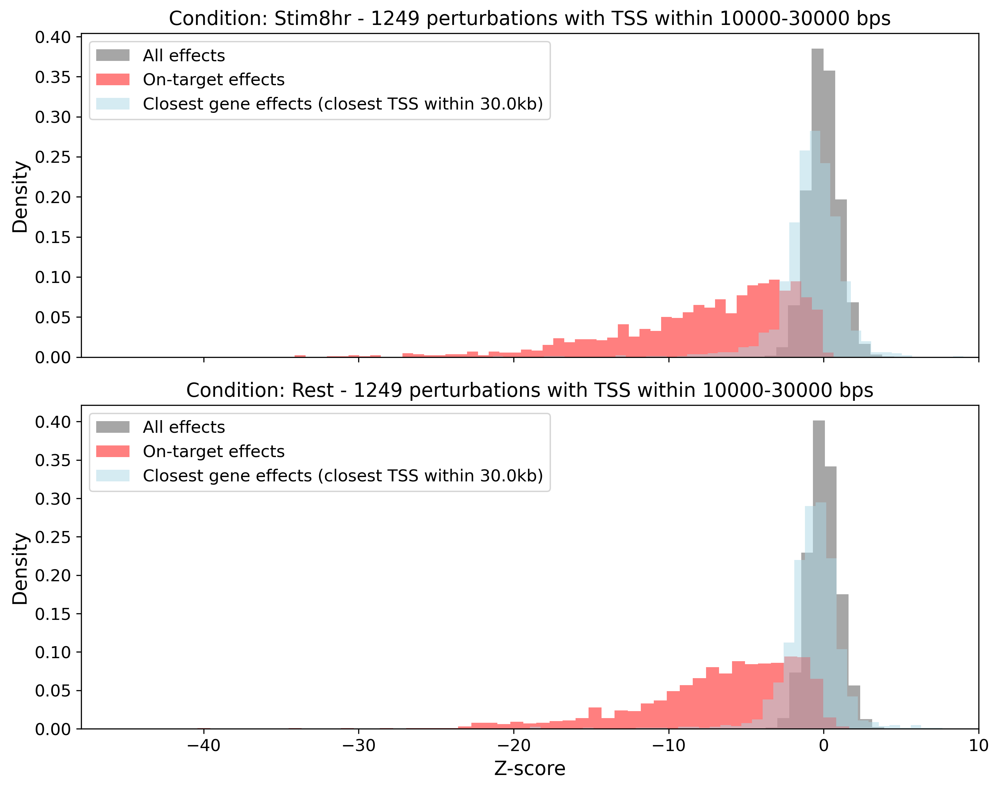

In [51]:
min_dist = 10000
max_dist = 30000
# Keep targets where the closest gene is between 10kb and 30kb away
keep_targets = all_ontarget_effect[all_ontarget_effect['rank'] == 1][
    (all_ontarget_effect[all_ontarget_effect['rank'] == 1].distance >= min_dist) & 
    (all_ontarget_effect[all_ontarget_effect['rank'] == 1].distance < max_dist)
].target_contrast.unique()
pl_df = all_ontarget_effect[all_ontarget_effect.target_contrast.isin(keep_targets)]
n_perts = pl_df.target_contrast.nunique()
# Create a figure with subplots, one for each condition
fig, axes = plt.subplots(len(conditions), 1, figsize=(10, 4*len(conditions)), sharex=True)

for i, cond in enumerate(conditions):
    axes[i].hist(adata_de[adata_de.obs['culture_condition'] == cond].layers['zscore'].flatten(), 
                bins=100, density=True, alpha=0.7, color='grey', label='All effects')
    # axes[i].hist(all_ontarget_effect[(all_ontarget_effect['rank'] == 0) & (all_ontarget_effect.culture_condition==cond)]['zscore'], bins=50, density=True, alpha=0.7, 
    #             color='red', label='On-target effects')
    axes[i].hist(pl_df[(pl_df['rank'] == 0) & (pl_df.culture_condition==cond)]['zscore'], bins=50, density=True, alpha=0.5, 
                color='red', label='On-target effects');
    axes[i].hist(pl_df[(pl_df['rank'] == 1) & (pl_df.culture_condition==cond)]['zscore'], bins=50, density=True, alpha=0.5, 
                color='lightblue', label=f'Closest gene effects (closest TSS within {max_dist/1000}kb)')
    
    axes[i].set_ylabel('Density', fontsize=14)
    axes[i].tick_params(labelsize=12)
    axes[i].legend(fontsize=12)
    axes[i].set_title(f'Condition: {cond} - {n_perts} perturbations with TSS within {min_dist}-{max_dist} bps', fontsize=14)
    axes[i].set_xlim(right=10)  # Set upper x-limit to 10

# Set common x-label
plt.xlabel('Z-score', fontsize=14)
plt.tight_layout()

In [52]:
# Keep targets where the closest gene is between 10kb and 30kb away
closest_gene_effect = all_ontarget_effect[all_ontarget_effect['rank'] == 1]
closest_gene_effect['distance_bins'] = pd.cut(
    closest_gene_effect['distance'],
    bins=[0, 10000, 20000, 30000, 40000, 50000, float('inf')],
    labels=['0-10kb', '10-20kb', '20-30kb', '30-40kb', '40-50kb', '>50kb']
)
closest_gene_effect = pd.concat([closest_gene_effect, all_ontarget_effect[all_ontarget_effect['rank'] == 0]])
closest_gene_effect['distance_bins'] = np.where(closest_gene_effect['rank'] == 0, 'on-target', closest_gene_effect['distance_bins'])
distance_bin_order = ['on-target', '0-10kb', '10-20kb', '20-30kb', '30-40kb', '40-50kb', '>50kb']
closest_gene_effect['distance_bins'] = pd.Categorical(
    closest_gene_effect['distance_bins'],
    categories=distance_bin_order,
    ordered=True
)
closest_gene_effect['gene_class'] = np.where(closest_gene_effect['distance_bins'] == 'on-target', 'target gene', 'closest TSS gene')
closest_gene_effect = closest_gene_effect.reset_index()

# Get mean and iqr across all genes
mean_zscore = np.median(adata_de.layers['zscore'].flatten())
iqr_zscore = np.percentile(adata_de.layers['zscore'].flatten(), 75) - np.percentile(adata_de.layers['zscore'].flatten(), 25)


/tmp/ipykernel_2797673/1033828811.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  closest_gene_effect['distance_bins'] = pd.cut(


/tmp/ipykernel_2797673/1641394385.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts = closest_gene_effect[closest_gene_effect['culture_condition'] == c].groupby(['distance_bins', 'gene_class']).size().unstack()
/tmp/ipykernel_2797673/1641394385.py:42: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


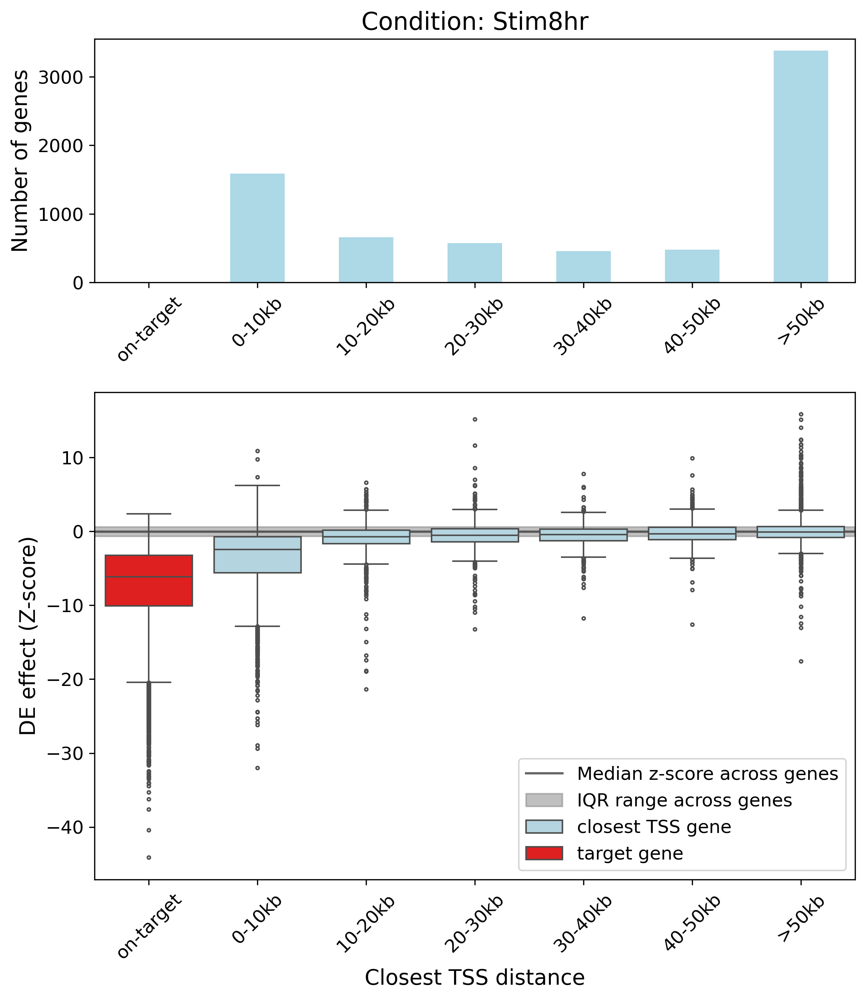

In [53]:
# Create figure with two subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(9, 10), height_ratios=[1, 2], gridspec_kw={'hspace': 0.3})

# Set font sizes
title_fontsize = 16
label_fontsize = 14
tick_fontsize = 12
legend_fontsize = 12

# Top subplot: Bar plot showing number of genes per class
c = 'Stim8hr'
counts = closest_gene_effect[closest_gene_effect['culture_condition'] == c].groupby(['distance_bins', 'gene_class']).size().unstack()
counts['closest TSS gene'].plot(kind='bar', ax=ax1, color='lightblue')
ax1.set_ylabel('Number of genes', fontsize=label_fontsize)
ax1.set_xlabel('', fontsize=label_fontsize)
ax1.set_title(f'Condition: {c}', fontsize=title_fontsize)
ax1.tick_params(axis='x', rotation=45, labelsize=tick_fontsize)
ax1.tick_params(axis='y', labelsize=tick_fontsize)

# Bottom subplot: Boxplot with custom colors and styling
# Add mean line and IQR shading to boxplot
ax2.axhline(y=mean_zscore, color='#404040', linestyle='-', alpha=0.8, label='Median z-score across genes')
ax2.axhspan(mean_zscore - iqr_zscore/2, mean_zscore + iqr_zscore/2, 
            color='grey', alpha=0.5, label='IQR range across genes')
            
sns.boxplot(
    data=closest_gene_effect, 
    x='distance_bins', 
    y='zscore',
    hue='gene_class',
    fliersize=2,  # Small black dots for outliers
    palette={'target gene': 'red', 'closest TSS gene': 'lightblue'},  # Custom color palette
    ax=ax2
)

ax2.set_ylabel('DE effect (Z-score)', fontsize=label_fontsize)
ax2.set_xlabel('Closest TSS distance', fontsize=label_fontsize)
ax2.tick_params(axis='x', rotation=45, labelsize=tick_fontsize)
ax2.tick_params(axis='y', labelsize=tick_fontsize)
ax2.legend(fontsize=legend_fontsize)

plt.tight_layout()

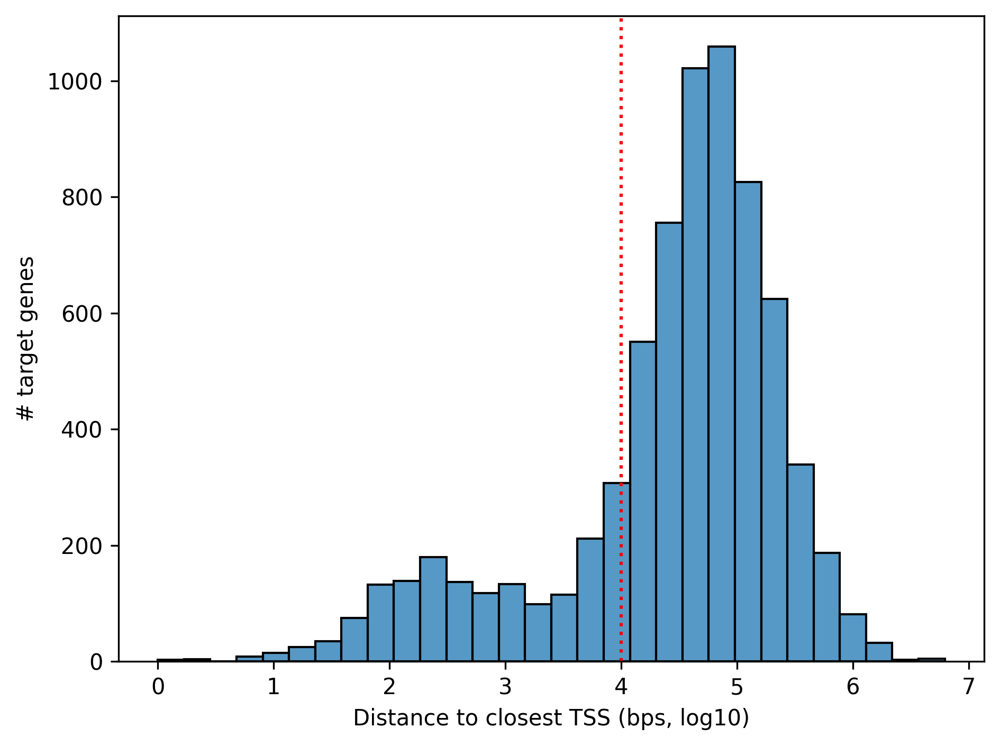

In [54]:
sns.histplot(np.log10(all_ontarget_effect[all_ontarget_effect['rank'] == 1][['target_contrast', 'distance']].drop_duplicates().distance.sort_values()+1), bins=30);
plt.axvline(np.log10(10000), linestyle=':', color='red');
plt.xlabel('Distance to closest TSS (bps, log10)');
plt.ylabel('# target genes');

In [55]:
sum(all_ontarget_effect[all_ontarget_effect['rank'] == 1][['target_contrast', 'distance']].drop_duplicates().distance < 10000)

1615

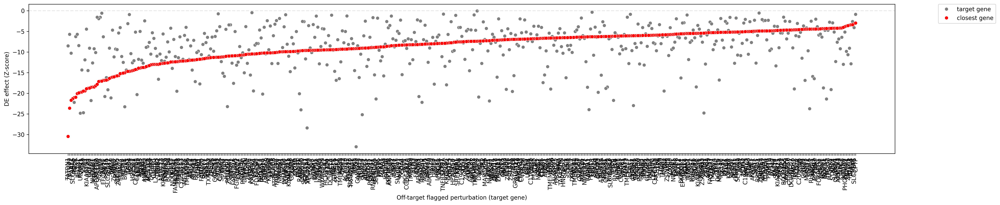

In [56]:
dist_thresh = 20000
effect_thresh = -1
all_ontarget_effect['adj_p_value'] = all_ontarget_effect['adj_p_value'].fillna(1)
keep_targets = all_ontarget_effect[all_ontarget_effect['rank'] == 1][all_ontarget_effect[all_ontarget_effect['rank'] == 1].distance < dist_thresh].target_contrast.unique()
pl_df = all_ontarget_effect[all_ontarget_effect.target_contrast.isin(keep_targets)]
heatmap_data = pl_df.pivot_table(
    values='zscore', 
    index='target_contrast', 
    columns='rank'
)
signif_heatmap_data = pl_df.pivot_table(
    values='adj_p_value', 
    index='target_contrast', 
    columns='rank'
)

# heatmap_data
suspect_mask = (heatmap_data[1] < effect_thresh) & (signif_heatmap_data[1] < 0.1) #& (heatmap_data[0] > (1.5*heatmap_data[1])) 
suspects = pl_df[pl_df.target_contrast.isin(heatmap_data[suspect_mask].index)].gene_name.dropna().unique().tolist()
pl_df = heatmap_data[suspect_mask].iloc[:, 0:2]
pl_df.index = suspects
order_targets = pl_df.sort_values(1).index
pl_df = pl_df.reset_index().melt(id_vars='index')
pl_df['index'] = pl_df['index'].astype('category').cat.reorder_categories(order_targets)
# Rename rank values for the legend
rank_labels = {0: 'target gene', 1: 'closest gene'}
pl_df['rank'] = pl_df['rank'].map(rank_labels)

plt.figure(figsize=(24,5))
sns.scatterplot(data=pl_df, x='index', y='value', hue='rank', palette=['grey', 'red'])
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.axhline(0, color='lightgray', linestyle='--', alpha=0.5)
plt.ylabel('DE effect (Z-score)')
plt.xlabel('Off-target flagged perturbation (target gene)')
plt.xticks(rotation=90);  # Rotate x-axis labels for better readability


In [57]:
len(suspects)/all_ontarget_effect.target_contrast.nunique()

0.07130988645804487

In [58]:
len(suspects)

515

## Power and number of cells

In [12]:
de_counts = get_de_stats(adata_de, effect_col='zscore', signif_col='adj_p_value', alpha=0.1)

In [60]:
de_counts.head()

,target_contrast,target_name,condition,n_cells_target,n_up_genes,n_down_genes,n_total_de_genes
ENSG00000038382_Stim8hr,ENSG00000038382,TRIO,Stim8hr,234.0,2,1,3
ENSG00000041988_Stim8hr,ENSG00000041988,THAP3,Stim8hr,428.0,3,2,5
ENSG00000066135_Stim8hr,ENSG00000066135,KDM4A,Stim8hr,1124.0,13,3,16
ENSG00000075336_Stim8hr,ENSG00000075336,TIMM21,Stim8hr,655.0,1,1,2
ENSG00000083535_Stim8hr,ENSG00000083535,PIBF1,Stim8hr,67.0,32,2,34


In [61]:
# Add info on on-target effect
effect_col = 'zscore'
if ontarget_df is not None:
    de_counts = pd.merge(
        de_counts,
        ontarget_df.rename({effect_col:'ontarget_effect_size', 'significant':'ontarget_significant', 'culture_condition':'condition'}, axis=1)[
        ['ontarget_effect_size', 'ontarget_significant', 'target_contrast', 'condition', 'baseMean']
        ]
    )

de_counts['offtarget_flag'] = de_counts.target_name.isin(suspects)

de_counts.head()

,target_contrast,target_name,condition,n_cells_target,n_up_genes,n_down_genes,n_total_de_genes,ontarget_effect_size,ontarget_significant,baseMean,offtarget_flag
0,ENSG00000038382,TRIO,Stim8hr,234.0,2,1,3,-2.855878,False,5.781150,False
1,ENSG00000041988,THAP3,Stim8hr,428.0,3,2,5,-7.914611,True,17.486059,False
2,ENSG00000066135,KDM4A,Stim8hr,1124.0,13,3,16,-15.575712,True,26.378239,False
3,ENSG00000075336,TIMM21,Stim8hr,655.0,1,1,2,-12.737983,True,53.224707,False
4,ENSG00000083535,PIBF1,Stim8hr,67.0,32,2,34,-3.649614,True,22.849449,False


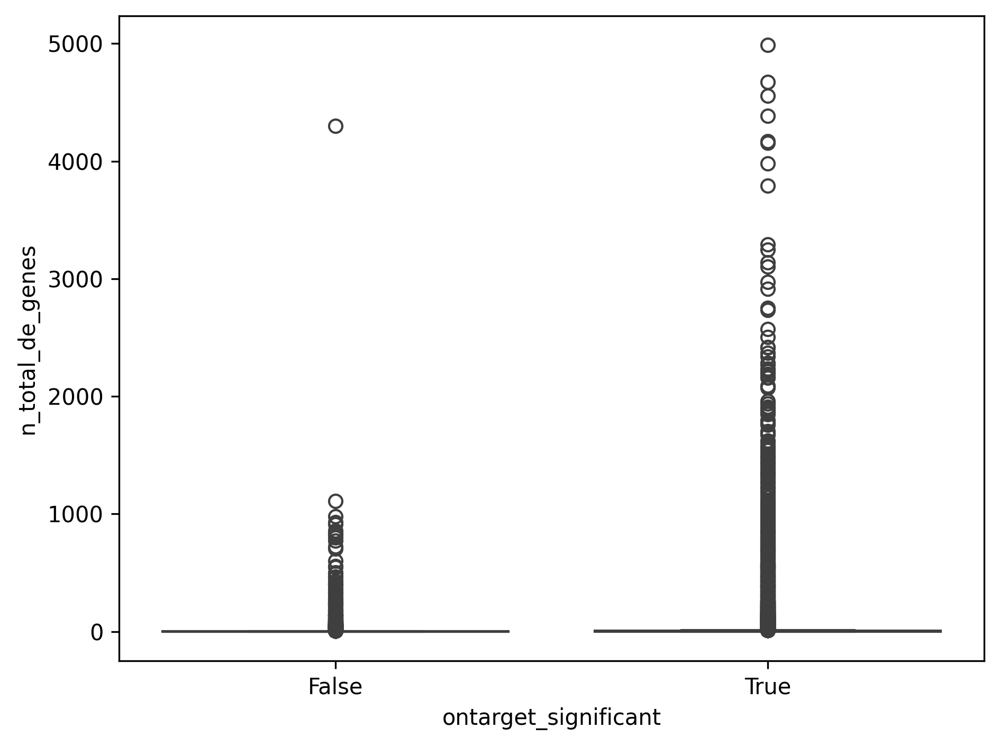

In [62]:
# Add a small constant to n_total_de_genes to handle zeros
de_counts_plot = de_counts.copy()
# de_counts_plot['n_total_de_genes_adj'] = de_counts_plot['n_total_de_genes']  # Add 1 to handle zeros

scatter = sns.boxplot(
    data=de_counts_plot, 
    x='ontarget_significant', 
    # hue='baseMean', 
    y='n_total_de_genes', 
    # s=3, palette='viridis',
    # hue_norm=LogNorm()
);
# plt.yscale('log')

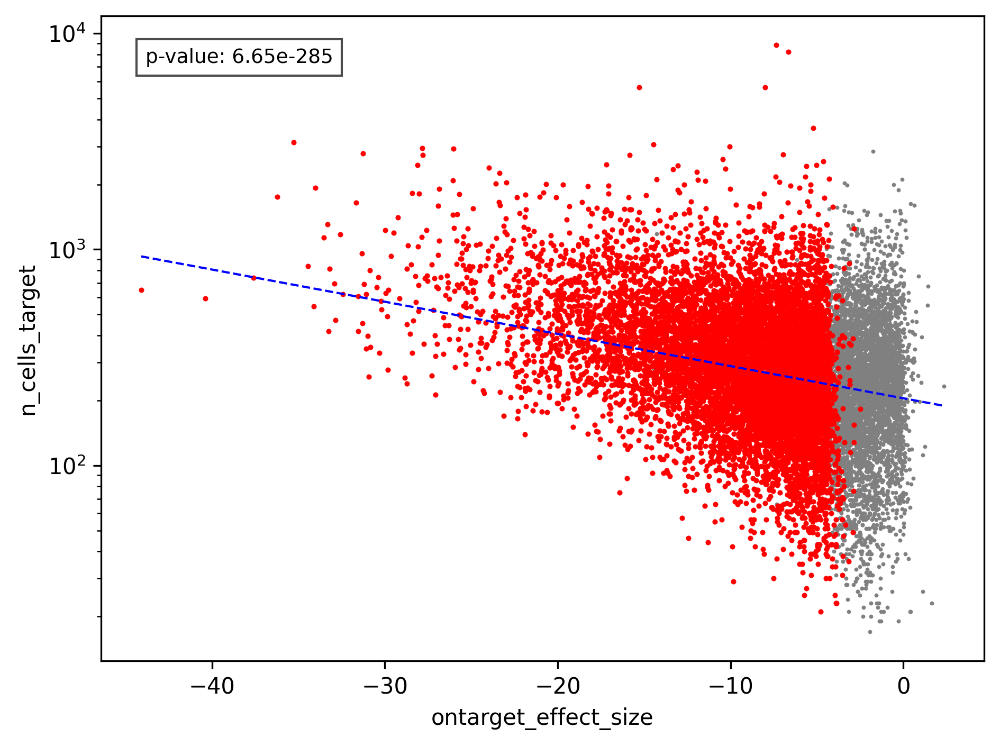

In [63]:
# Create scatter plot for all data points
sns.scatterplot(
    data=de_counts_plot, 
    x='ontarget_effect_size', 
    y='n_cells_target', color='grey',
    s=3, edgecolor=None
);

# Add scatter plot for significant points
sns.scatterplot(
    data=de_counts_plot[de_counts_plot['ontarget_significant']], 
    x='ontarget_effect_size', 
    y='n_cells_target', 
    color='red',
    s=5, edgecolor=None
);

# Add linear trend line
from scipy import stats
# Calculate linear regression
slope, intercept, r_value, p_value, std_err = stats.linregress(
    de_counts_plot['ontarget_effect_size'], 
    de_counts_plot['n_cells_target']
)
# Plot the line
x = np.array([de_counts_plot['ontarget_effect_size'].min(), de_counts_plot['ontarget_effect_size'].max()])
y = intercept + slope * x
plt.plot(x, y, 'b--', linewidth=1)

# Add p-value annotation
plt.annotate(f"p-value: {p_value:.2e}", xy=(0.05, 0.95), xycoords='axes fraction', 
             fontsize=9, ha='left', va='top',
             bbox=dict(fc='white', alpha=0.7))
# sns.scatterplot(
#     data=de_counts_plot[(~de_counts_plot['ontarget_significant']) & (de_counts_plot['offtarget_flag'])], 
#     x='ontarget_effect_size', 
#     y='n_cells_target', 
#     color='green',
#     s=5, edgecolor=None
# );

plt.yscale('log')

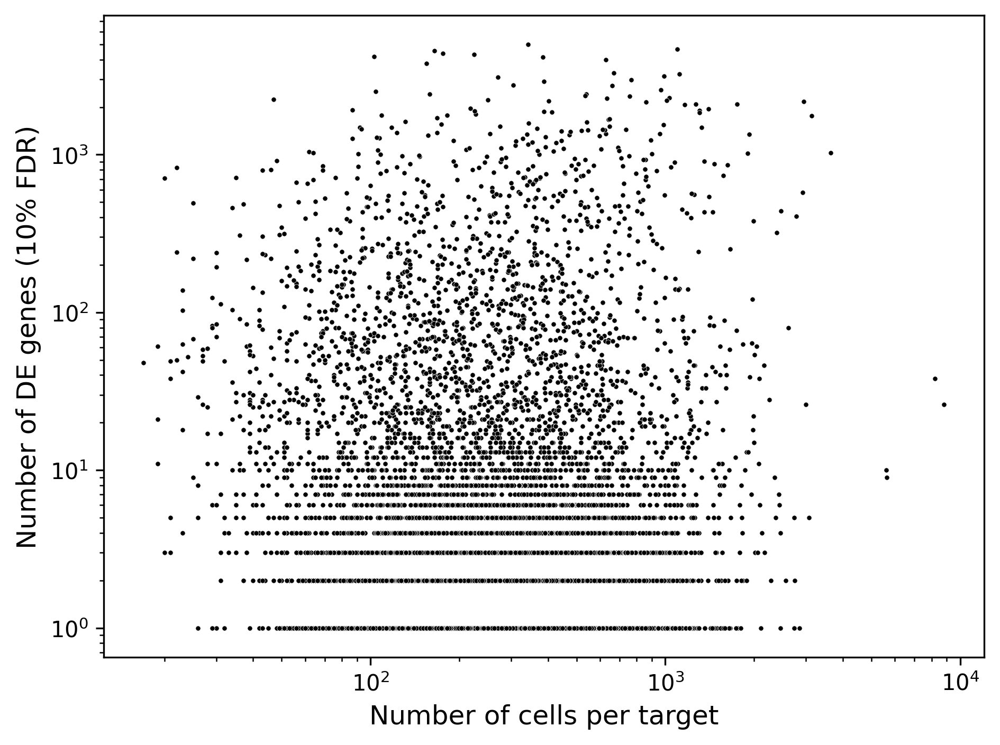

In [64]:
sns.scatterplot(
    data=de_counts,
    x='n_cells_target',
    y='n_total_de_genes',
    color='black', s=5
)
plt.xlabel('Number of cells per target', fontsize=12)
plt.ylabel('Number of DE genes (10% FDR)', fontsize=12)
plt.xscale('log');plt.yscale('log');
plt.tight_layout()

## Number of DE genes per perturbation

/tmp/ipykernel_2797673/1056732313.py:29: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_counts = de_counts[de_counts['condition'] == c].groupby(['n_total_genes_category', 'ontarget_effect_category']).size().reset_index(name='count')
/tmp/ipykernel_2797673/1056732313.py:29: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_counts = de_counts[de_counts['condition'] == c].groupby(['n_total_genes_category', 'ontarget_effect_category']).size().reset_index(name='count')
/tmp/ipykernel_2797673/1056732313.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a fut

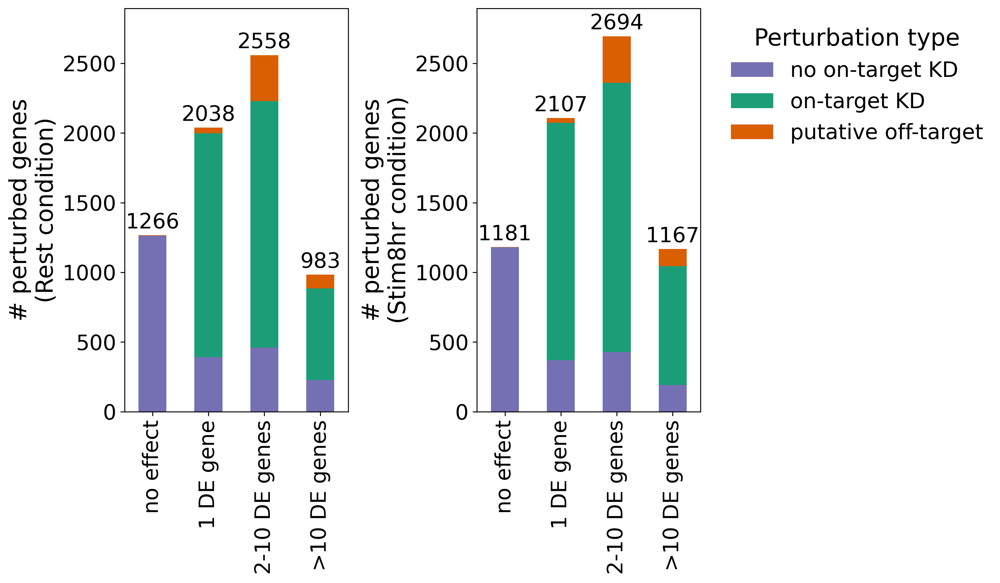

In [65]:
# Create categories for number of DE genes with a logical order
de_counts['n_total_genes_category'] = np.nan
de_counts['n_total_genes_category'] = np.where(de_counts['n_total_de_genes'] == 0, 'no effect', de_counts['n_total_genes_category'])
de_counts['n_total_genes_category'] = np.where(de_counts['n_total_de_genes'] == 1, '1 DE gene', de_counts['n_total_genes_category'])
de_counts['n_total_genes_category'] = np.where((de_counts['n_total_de_genes'] > 1) & (de_counts['n_total_de_genes'] <= 10), '2-10 DE genes', de_counts['n_total_genes_category'])
de_counts['n_total_genes_category'] = np.where((de_counts['n_total_de_genes'] > 10), '>10 DE genes', de_counts['n_total_genes_category'])

# Create a categorical type with ordered categories
category_order = ['no effect', '1 DE gene', '2-10 DE genes', '>10 DE genes']
de_counts['n_total_genes_category'] = pd.Categorical(
    de_counts['n_total_genes_category'],
    categories=category_order,
    ordered=True
)

de_counts['ontarget_effect_category'] = 'on-target KD'
de_counts['ontarget_effect_category'] = np.where(~de_counts['ontarget_significant'], 'no on-target KD', de_counts['ontarget_effect_category'])
de_counts['ontarget_effect_category'] = np.where(de_counts['offtarget_flag'], 'putative off-target', de_counts['ontarget_effect_category'])

# Barplot
fig, axes = plt.subplots(1, 2, figsize=(12, 7))

colors = {'on-target KD': '#7570b3', 'putative off-target':'#1b9e77', 'no on-target KD': '#d95f02'}

# Plot for each condition
# Get max y value across both conditions to set consistent ylim
max_y = 0
for c in ['Rest', 'Stim8hr']:
    grouped_counts = de_counts[de_counts['condition'] == c].groupby(['n_total_genes_category', 'ontarget_effect_category']).size().reset_index(name='count')
    grouped_counts = grouped_counts.pivot(index='n_total_genes_category', columns='ontarget_effect_category', values='count').fillna(0)
    max_y = max(max_y, grouped_counts.sum(axis=1).max())

for i, c in enumerate(['Rest', 'Stim8hr']):
    ax = axes[i]
    
    # Get grouped counts for this condition
    grouped_counts = de_counts[de_counts['condition'] == c].groupby(['n_total_genes_category', 'ontarget_effect_category']).size().reset_index(name='count')
    grouped_counts = grouped_counts.pivot(index='n_total_genes_category', columns='ontarget_effect_category', values='count').fillna(0)
    
    # Create stacked bar plot
    grouped_counts.plot(kind='bar', color=colors.values(), stacked=True, ax=ax)
    ax.set_xlabel('', fontsize=20)
    ax.set_ylabel(f'# perturbed genes\n({c} condition)', fontsize=20)
    # ax.tick_params(axis='x', rotation=45, ha='right')
    
    # Set consistent y limits
    ax.set_ylim(0, max_y + 200)  # Add some padding for labels
    
    if i != 0:
        ax.legend(title='Perturbation type', frameon=False, fontsize=18, title_fontsize=20, 
                 bbox_to_anchor=(1.05, 1), loc='upper left')
    else:
        ax.get_legend().remove()
    # Add count labels on top of each bar
    for i, total in enumerate(grouped_counts.sum(axis=1)):
        ax.text(i, total + 50, str(int(total)), ha='center', fontsize=18)
    
    # Increase tick label sizes
    ax.tick_params(axis='both', which='major', labelsize=18)

plt.tight_layout()

In [66]:
de_counts

,target_contrast,target_name,condition,n_cells_target,n_up_genes,n_down_genes,n_total_de_genes,ontarget_effect_size,ontarget_significant,baseMean,offtarget_flag,n_total_genes_category,ontarget_effect_category
0,ENSG00000038382,TRIO,Stim8hr,234.0,2,1,3,-2.855878,False,5.781150,False,2-10 DE genes,no on-target KD
1,ENSG00000041988,THAP3,Stim8hr,428.0,3,2,5,-7.914611,True,17.486059,False,2-10 DE genes,on-target KD
2,ENSG00000066135,KDM4A,Stim8hr,1124.0,13,3,16,-15.575712,True,26.378239,False,>10 DE genes,on-target KD
3,ENSG00000075336,TIMM21,Stim8hr,655.0,1,1,2,-12.737983,True,53.224707,False,2-10 DE genes,on-target KD
4,ENSG00000083535,PIBF1,Stim8hr,67.0,32,2,34,-3.649614,True,22.849449,False,>10 DE genes,on-target KD
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13989,ENSG00000222011,FAM185A,Rest,611.0,1,2,3,-5.555593,True,5.715774,False,2-10 DE genes,on-target KD
13990,ENSG00000240204,SMKR1,Rest,214.0,1,0,1,-1.697604,False,2.066255,False,1 DE gene,no on-target KD
13991,ENSG00000247315,ZCCHC3,Rest,467.0,0,2,2,-13.585780,True,40.738033,False,2-10 DE genes,on-target KD
13992,ENSG00000263001,GTF2I,Rest,429.0,6,1,7,-12.369883,True,43.196083,False,2-10 DE genes,on-target KD


In [ ]:
de_counts.to_csv(f'../../results/{experiment_name}/DE_summary_stats_per_target.csv')
de_counts.to_csv(f'{datadir}/DE_results_all_confounders/DE_summary_stats_per_target.csv')
de_counts.head()

In [17]:
de_counts = pd.read_csv(f'{datadir}/DE_results_all_confounders/DE_summary_stats_per_target.csv', index_col=0)
de_counts.head()

,target_contrast,target_name,condition,n_cells_target,n_up_genes,n_down_genes,n_total_de_genes,ontarget_effect_size,ontarget_significant,baseMean,offtarget_flag,n_total_genes_category,ontarget_effect_category
0,ENSG00000038382,TRIO,Stim8hr,234.0,2,1,3,-2.855878,False,5.781150,False,2-10 DE genes,no on-target KD
1,ENSG00000041988,THAP3,Stim8hr,428.0,3,2,5,-7.914611,True,17.486059,False,2-10 DE genes,on-target KD
2,ENSG00000066135,KDM4A,Stim8hr,1124.0,13,3,16,-15.575712,True,26.378239,False,>10 DE genes,on-target KD
3,ENSG00000075336,TIMM21,Stim8hr,655.0,1,1,2,-12.737983,True,53.224707,False,2-10 DE genes,on-target KD
4,ENSG00000083535,PIBF1,Stim8hr,67.0,32,2,34,-3.649614,True,22.849449,False,>10 DE genes,on-target KD


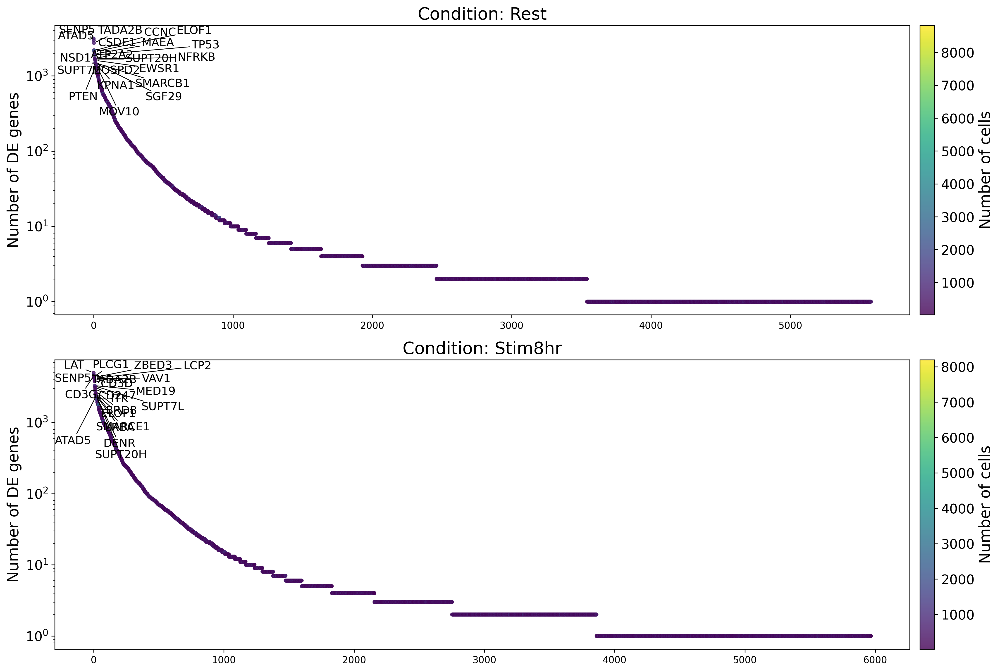

In [67]:
from adjustText import adjust_text

plt.figure(figsize=(16, 10))

for condition in ['Rest', 'Stim8hr']:
    plt.subplot(2, 1, 1 if condition == 'Rest' else 2)
    
    # Filter data for current condition
    condition_df = de_counts[de_counts['condition'] == condition].sort_values('n_total_de_genes', ascending=False)
    condition_df = condition_df[condition_df['n_total_de_genes'] > 0]
    
    if len(condition_df) > 0:
        scatter = plt.scatter(range(len(condition_df)), condition_df['n_total_de_genes'].values, 
                             c=condition_df['n_cells_target'], cmap='viridis', alpha=0.8, s=10)
        cbar = plt.colorbar(scatter, label='Number of cells', pad=0.01)
        cbar.ax.tick_params(labelsize=14)
        cbar.set_label('Number of cells', fontsize=16)
        
        plt.ylabel('Number of DE genes', fontsize=16)
        plt.title(f'Condition: {condition}', fontsize=18)
        plt.yscale('log')
        # plt.xticks([])
        plt.yticks(fontsize=14)
        
        # Get top 20 targets with most DE genes
        top20_targets = condition_df.head(20)
        
        # Create annotations for top targets
        texts = []
        for i, row in top20_targets.iterrows():
            idx = condition_df.index.get_loc(i)
            texts.append(plt.text(idx, row['n_total_de_genes'], row.target_name, fontsize=12))
        
        # Use adjustText to prevent overlapping labels
        adjust_text(texts, arrowprops=dict(arrowstyle='->', color='black', lw=0.8))
    else:
        plt.text(0.5, 0.5, f"No DE genes for condition: {condition}", 
                 horizontalalignment='center', verticalalignment='center', fontsize=16)

plt.tight_layout()

In [68]:
from DE_analysis_utils import *

Looks like you are using a tranform that doesn't support FancyArrowPatch, using ax.annotate instead. The arrows might strike through texts. Increasing shrinkA in arrowprops might help.


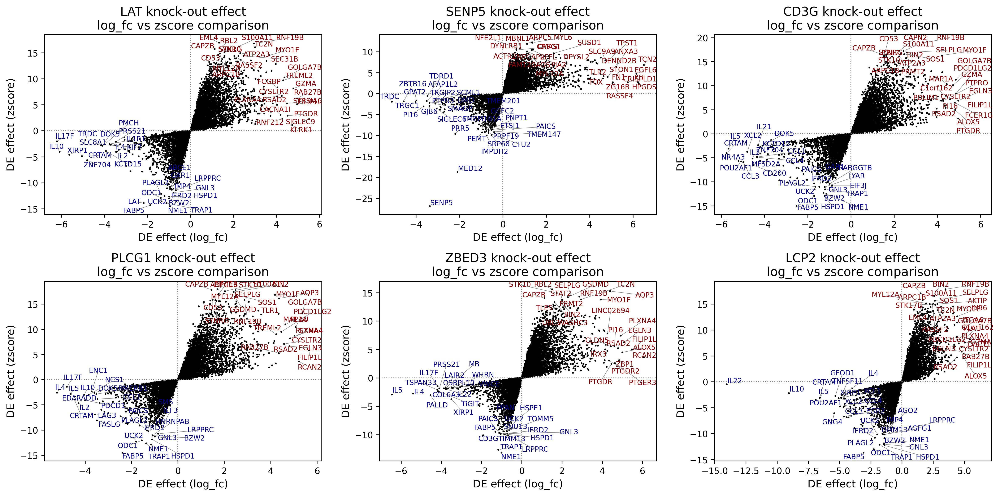

In [69]:
adata_de.var_names = adata_de.var['gene_name'].values
top_gs = condition_df.sort_values('n_total_de_genes', ascending=False)['target_name'][0:6].tolist()

# Create a figure with 3 columns and 2 rows
fig, axs = plt.subplots(2, 3, figsize=(16, 8))
axs = axs.flatten()  # Flatten to easily iterate through subplots

# Plot each of the top 6 genes in its own subplot
for i, g in enumerate(top_gs):
    _, res = plot_effect_comparison(
        adata_de, 
        comparison_params = {
            'target_contrast_gene_name':[g],
            'culture_condition':['Stim8hr'],
            'stat':['log_fc','zscore']
        },
        ax = axs[i]
    )

plt.tight_layout()

## Compare to Freimer arrayed RNA-seq

In [18]:
freimer_df = pd.read_csv('/mnt/oak/users/emma/data/Supplementary_Data_1_RNA_Seq_results.csv')
freimer_kos = [x.replace(" KO", '') for x in freimer_df['sample'].unique().tolist()]
common_perturbations = np.intersect1d(freimer_kos, adata_de[adata_de.obs.culture_condition == 'Rest'].obs['target_contrast_gene_name'])

In [19]:
len(common_perturbations)

17

In [20]:
adata_de.var_names = adata_de.var['gene_ids'].values

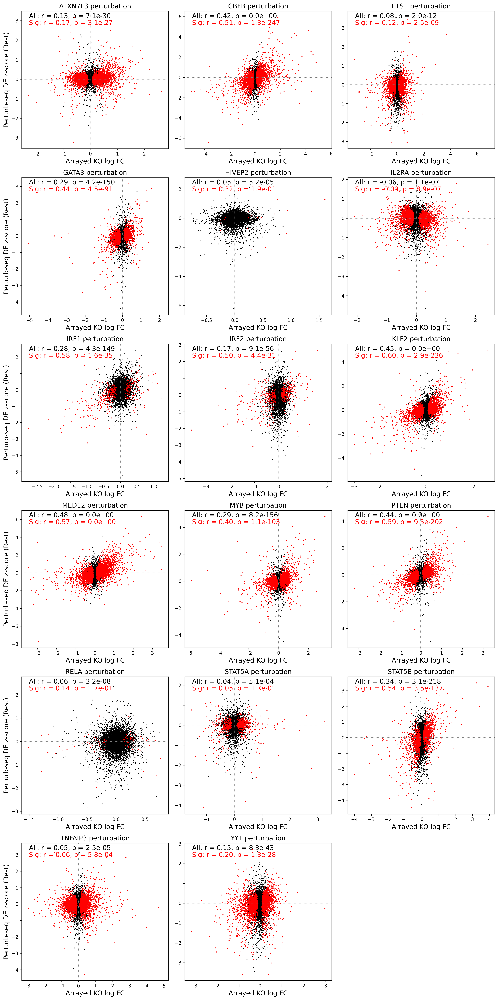

In [21]:
import scipy
import matplotlib.pyplot as plt

# Calculate number of rows and columns needed
n_plots = len(common_perturbations)
n_cols = 3  # Fixed number of columns
n_rows = (n_plots + n_cols - 1) // n_cols  # Ceiling division

# Create a figure with subplots arranged in multiple rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5*n_rows))
axes = axes.flatten()  # Flatten to easily iterate through subplots

for i, g in enumerate(common_perturbations):
    # Get data for this perturbation
    gwt_effect_g = sc.get.var_df(adata_de, adata_de.obs_names[adata_de.obs['target_contrast_gene_name'] == g].tolist(), layer='log_fc')
    gwt_effect_g.columns = gwt_effect_g.columns.str.split("_").str[1]
    freimer_effect_g = freimer_df[freimer_df['sample'] == f'{g} KO'].set_index('ens_id')[['logFC']]
    freimer_effect_g['signif'] = freimer_df[freimer_df['sample'] == f'{g} KO'].set_index('ens_id')['adj.P.Val'] < 0.1

    concat_df = pd.concat([freimer_effect_g, gwt_effect_g], axis=1).dropna()

    # Calculate correlation coefficients and p-values for Rest condition only
    rest_corr, rest_pval = scipy.stats.pearsonr(concat_df['logFC'], concat_df['Rest'])
    rest_signif_corr, rest_signif_pval = scipy.stats.pearsonr(
        concat_df[concat_df['signif']]['logFC'], 
        concat_df[concat_df['signif']]['Rest']
    ) if sum(concat_df['signif']) > 1 else (float('nan'), float('nan'))

    # Create scatter plot for Rest condition
    sns.scatterplot(data=concat_df, x='logFC', y='Rest', s=4, edgecolor='none', color='black', ax=axes[i])
    sns.scatterplot(data=concat_df[concat_df['signif']], x='logFC', y='Rest', s=5, edgecolor='none', color='red', ax=axes[i])

    # Add correlation information as text
    axes[i].annotate(f'All: r = {rest_corr:.2f}, p = {rest_pval:.1e}', 
                xy=(0.05, 0.95), xycoords='axes fraction', fontsize=14)
    if not np.isnan(rest_signif_corr):
        axes[i].annotate(f'Sig: r = {rest_signif_corr:.2f}, p = {rest_signif_pval:.1e}', 
                    xy=(0.05, 0.90), xycoords='axes fraction', fontsize=14, color='red')

    # Add dotted lines for x and y axes
    axes[i].axhline(y=0, color='gray', linestyle=':', linewidth=1)
    axes[i].axvline(x=0, color='gray', linestyle=':', linewidth=1)
    
    # Set title and labels
    axes[i].set_title(f'{g} perturbation', fontsize=14)
    
    # Only add y-label for plots in the first column
    if i % n_cols == 0:
        axes[i].set_ylabel('Perturb-seq DE z-score (Rest)', fontsize=14)
    else:
        axes[i].set_ylabel('')
    
    axes[i].set_xlabel('Arrayed KO log FC', fontsize=14)

# Hide any unused subplots
for i in range(len(common_perturbations), len(axes)):
    axes[i].set_visible(False)

plt.tight_layout()
plt.show()

## Compare effects in 2 conditions

In [74]:
# Create a dataframe to store correlation results
correlation_results = pd.DataFrame(columns=['target_name', 'correlation', 'pvalue'])

# Get perturbations measured in both conditions
perturbations_both_conditions = []
for g in adata_de.obs['target_contrast_gene_name'].unique():
    gwt_effect_g = sc.get.var_df(adata_de, adata_de.obs_names[adata_de.obs['target_contrast_gene_name'] == g].tolist(), layer='zscore').dropna()
    gwt_effect_g.columns = gwt_effect_g.columns.str.split("_").str[1]
    
    # Check if perturbation has measurements in both conditions
    if 'Rest' in gwt_effect_g.columns and 'Stim8hr' in gwt_effect_g.columns:
        perturbations_both_conditions.append(g)

# Calculate correlations only for perturbations in both conditions
for g in perturbations_both_conditions:
    gwt_effect_g = sc.get.var_df(adata_de, adata_de.obs_names[adata_de.obs['target_contrast_gene_name'] == g].tolist(), layer='zscore').dropna()
    gwt_effect_g.columns = gwt_effect_g.columns.str.split("_").str[1]
    
    # Calculate correlation between conditions
    r2, pval = scipy.stats.pearsonr(gwt_effect_g['Stim8hr'], gwt_effect_g['Rest'])
    
    # Add results to the dataframe
    correlation_results = pd.concat([correlation_results, pd.DataFrame({
        'target_name': [g],
        'correlation': [r2],
        'pvalue': [pval]
    })], ignore_index=True)

n_cells_df = de_counts.pivot(columns='condition', index='target_name',values='n_cells_target').reset_index().rename({'Rest':'n_cells_Rest', 'Stim8hr':'n_cells_Stim8hr'}, axis=1)
n_de_genes_df = de_counts.pivot(columns='condition', index='target_name',values='n_total_de_genes').reset_index().rename({'Rest':'n_de_genes_Rest', 'Stim8hr':'n_de_genes_Stim8hr'}, axis=1)

correlation_results = pd.merge(pd.merge(correlation_results, n_de_genes_df), n_cells_df)

/tmp/ipykernel_2797673/2028497385.py:23: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  correlation_results = pd.concat([correlation_results, pd.DataFrame({


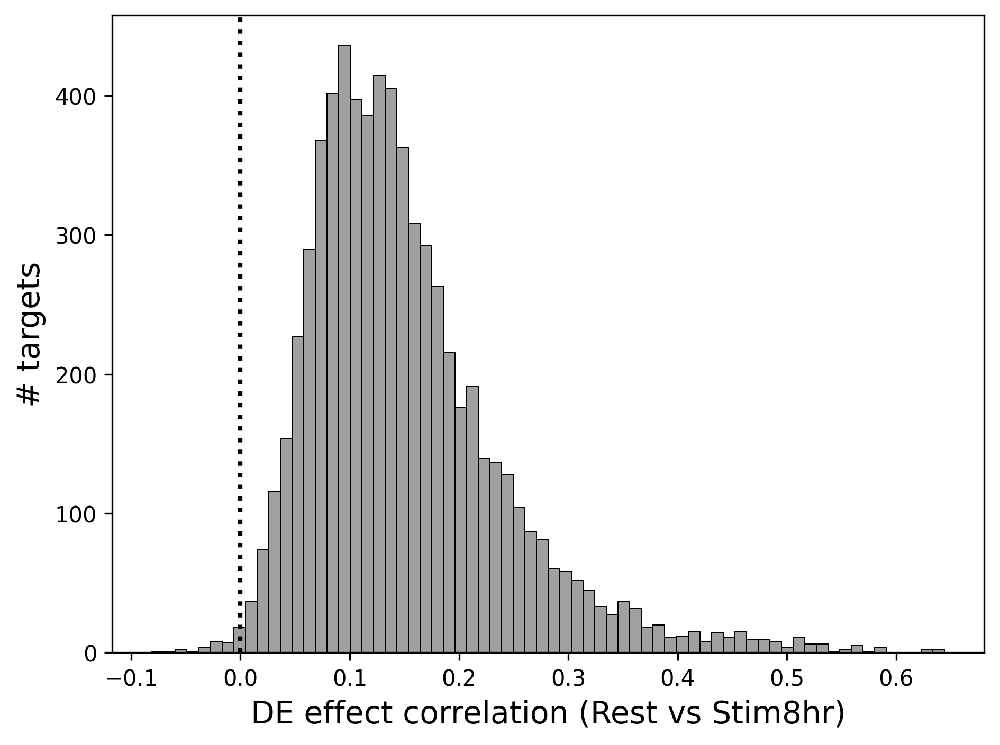

In [75]:
sns.histplot(data=correlation_results, x='correlation', color='grey');
plt.axvline(x=0, color='black', linestyle=':', linewidth=2)
plt.xlabel('DE effect correlation (Rest vs Stim8hr)', fontsize=14)
plt.ylabel('# targets', fontsize=14);

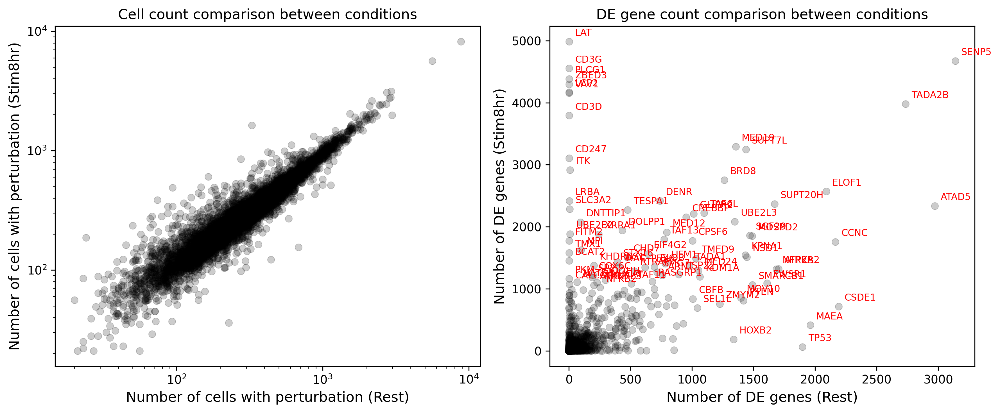

In [76]:
# Create a figure with 2 subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# First subplot: Cell counts comparison
sns.scatterplot(data=correlation_results, x='n_cells_Rest', y='n_cells_Stim8hr', 
                alpha=0.2, edgecolor=None, color='black', ax=ax1)
ax1.set_xscale('log')
ax1.set_yscale('log')
ax1.set_xlabel('Number of cells with perturbation (Rest)', fontsize=12)
ax1.set_ylabel('Number of cells with perturbation (Stim8hr)', fontsize=12)
ax1.set_title('Cell count comparison between conditions')
# # Add dotted diagonal line
# ax1.plot([1, 10000], [1, 10000], 'k:', alpha=0.7)  # Diagonal line from (1,1) to (10000,10000)

# Second subplot: DE genes comparison
sns.scatterplot(data=correlation_results, x='n_de_genes_Rest', y='n_de_genes_Stim8hr', 
                alpha=0.2, edgecolor=None, color='black', ax=ax2)
ax2.set_xlabel('Number of DE genes (Rest)', fontsize=12)
ax2.set_ylabel('Number of DE genes (Stim8hr)', fontsize=12)
ax2.set_title('DE gene count comparison between conditions')

# Identify genes with >200 DE genes in any condition
genes_to_annotate = correlation_results[(correlation_results['n_de_genes_Rest'] > 1000) | 
                                       (correlation_results['n_de_genes_Stim8hr'] > 1000)]

# Annotate these genes in the second plot
for _, row in genes_to_annotate.iterrows():
    ax2.annotate(row['target_name'], 
                xy=(row['n_de_genes_Rest'], row['n_de_genes_Stim8hr']),
                xytext=(5, 5), textcoords='offset points',
                fontsize=8, color='red')

plt.tight_layout()
# plt.xscale('log');plt.yscale('log');

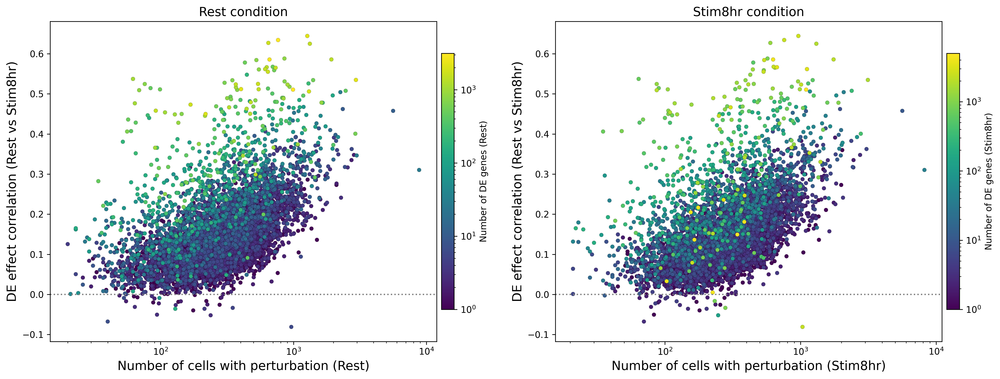

In [77]:
# Sort data so points with most DE genes are plotted on top
# Sort data for both conditions
sorted_data_stim = correlation_results.sort_values('n_de_genes_Stim8hr', ascending=True)
sorted_data_rest = correlation_results.sort_values('n_de_genes_Rest', ascending=True)

# Create a log-normalized color scale for the DE genes
from matplotlib.colors import LogNorm

# Create a figure with 2 subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# First subplot: Rest condition
scatter1 = ax1.scatter(sorted_data_rest['n_cells_Rest'], sorted_data_rest['correlation'],
                     c=sorted_data_rest['n_de_genes_Rest']+1, s=20, alpha=1, linewidths=0.1,
                     edgecolor='black', cmap='viridis', 
                     norm=LogNorm(vmin=1, vmax=sorted_data_rest['n_de_genes_Rest'].max())
                     )

ax1.axhline(0, color='grey', linestyle=':')
ax1.set_xscale('log')
ax1.set_xlabel('Number of cells with perturbation (Rest)', fontsize=14)
ax1.set_ylabel('DE effect correlation (Rest vs Stim8hr)', fontsize=14)
ax1.set_title('Rest condition', fontsize=14)
plt.colorbar(scatter1, ax=ax1, label='Number of DE genes (Rest)', pad=0.01, 
             orientation='vertical', shrink=0.8, aspect=20)

# Second subplot: Stim8hr condition
scatter2 = ax2.scatter(sorted_data_stim['n_cells_Stim8hr'], sorted_data_stim['correlation'],
                     c=sorted_data_stim['n_de_genes_Stim8hr']+1, s=20, alpha=1, linewidths=0.1,
                     edgecolor='black', cmap='viridis', 
                     norm=LogNorm(vmin=1, vmax=sorted_data_stim['n_de_genes_Stim8hr'].max())
                     )

ax2.axhline(0, color='grey', linestyle=':')
ax2.set_xscale('log')
ax2.set_xlabel('Number of cells with perturbation (Stim8hr)', fontsize=14)
ax2.set_ylabel('DE effect correlation (Rest vs Stim8hr)', fontsize=14)
ax2.set_title('Stim8hr condition', fontsize=14)
plt.colorbar(scatter2, ax=ax2, label='Number of DE genes (Stim8hr)', pad=0.01, 
             orientation='vertical', shrink=0.8, aspect=20)

plt.tight_layout()


## Incoming vs Outgoing effects

In [78]:
targets_de_counts = get_de_stats(adata_de, signif_col='adj_p_value', effect_col='zscore', alpha=0.1, axis='targets')
genes_de_counts = get_de_stats(adata_de, signif_col='adj_p_value', effect_col='zscore',alpha=0.1, axis='genes')

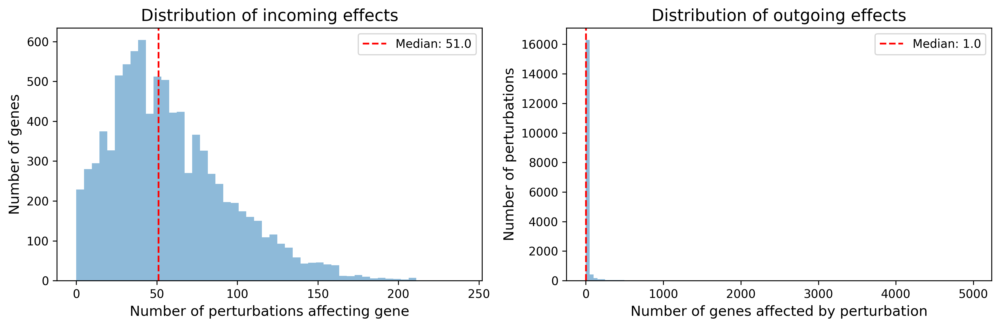

In [87]:
# Create a figure with 2 subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

# First subplot: Incoming effects
ax1.hist(genes_de_counts['n_total_de_targets'], 
         bins=50, 
         alpha=0.5)
ax1.set_xlabel('Number of perturbations affecting gene', fontsize=12)
ax1.set_ylabel('Number of genes', fontsize=12)
ax1.set_title('Distribution of incoming effects', fontsize=14)
# Add median line for incoming effects
median_incoming = genes_de_counts['n_total_de_targets'].median()
ax1.axvline(median_incoming, color='red', linestyle='--', 
            label=f'Median: {median_incoming:.1f}')
ax1.legend()

# Second subplot: Outgoing effects
ax2.hist(targets_de_counts['n_total_de_genes'], 
         bins=100, 
         alpha=0.5)
ax2.set_xlabel('Number of genes affected by perturbation', fontsize=12)
ax2.set_ylabel('Number of perturbations', fontsize=12)
ax2.set_title('Distribution of outgoing effects', fontsize=14)
# Add median line for outgoing effects
median_outgoing = targets_de_counts['n_total_de_genes'].median()
ax2.axvline(median_outgoing, color='red', linestyle='--',
            label=f'Median: {median_outgoing:.1f}')
ax2.legend()

plt.tight_layout()

In [88]:
# Merge the genes and targets counts for the same gene
targets_de_counts['gene_id'] = targets_de_counts['target_contrast']

# Merge the dataframes on gene_id
merged_counts = pd.merge(
    genes_de_counts[['gene_id', 'gene_name', 'n_total_de_targets']], 
    targets_de_counts[['gene_id', 'n_total_de_genes', 'condition']],
    on='gene_id',
    how='outer',
    suffixes=('_incoming', '_outgoing')
)

# Fill NaN values with 0 for genes that don't have both incoming and outgoing effects
merged_counts['n_total_de_targets'] = merged_counts['n_total_de_targets'].fillna(0).astype(int)
merged_counts['n_total_de_genes'] = merged_counts['n_total_de_genes'].fillna(0).astype(int)
merged_counts

,gene_id,gene_name,n_total_de_targets,n_total_de_genes,condition
0,AKAP2,NaN,0,4,Stim8hr
1,AKAP2,NaN,0,2,Rest
2,ENSG00000000003,NaN,0,1,Rest
3,ENSG00000000003,NaN,0,0,Stim8hr
4,ENSG00000000419,DPM1,65,3,Rest
...,...,...,...,...,...
19433,SGK494,NaN,0,2,Stim8hr
19434,SGK494,NaN,0,0,Rest
19435,SMIM11B,NaN,0,0,Rest
19436,SMIM11B,NaN,0,0,Stim8hr


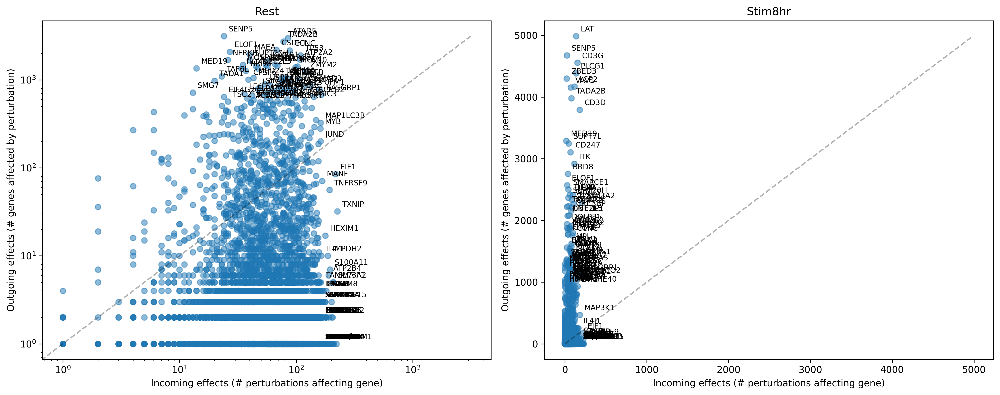

In [91]:
# Split the data by condition using the condition column
rest_data = merged_counts[merged_counts['condition'] == 'Rest']
stim_data = merged_counts[merged_counts['condition'] == 'Stim8hr']

# Create a figure with 2 subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Plot for Rest condition
ax1.scatter(
    rest_data['n_total_de_targets'], 
    rest_data['n_total_de_genes'],
    alpha=0.5
)
ax1.set_xlabel('Incoming effects (# perturbations affecting gene)')
ax1.set_ylabel('Outgoing effects (# genes affected by perturbation)')
ax1.set_xscale('log')
ax1.set_yscale('log')
ax1.set_title('Rest')

# Add diagonal line for Rest
max_val_rest = max(rest_data['n_total_de_targets'].max(), rest_data['n_total_de_genes'].max())
ax1.plot([0, max_val_rest], [0, max_val_rest], 'k--', alpha=0.3)

# Plot for Stim8hr condition
ax2.scatter(
    stim_data['n_total_de_targets'], 
    stim_data['n_total_de_genes'],
    alpha=0.5
)
ax2.set_xlabel('Incoming effects (# perturbations affecting gene)')
ax2.set_ylabel('Outgoing effects (# genes affected by perturbation)')
# ax2.set_xscale('log')
# ax2.set_yscale('log')
ax2.set_title('Stim8hr')

# Add diagonal line for Stim8hr
max_val_stim = max(stim_data['n_total_de_targets'].max(), stim_data['n_total_de_genes'].max())
ax2.plot([0, max_val_stim], [0, max_val_stim], 'k--', alpha=0.3)

# Add annotations for interesting genes in each subplot
threshold_incoming_rest = rest_data['n_total_de_targets'].quantile(0.99)
threshold_outgoing_rest = rest_data['n_total_de_genes'].quantile(0.99)

for idx, row in rest_data.iterrows():
    if row['n_total_de_targets'] > threshold_incoming_rest or row['n_total_de_genes'] > threshold_outgoing_rest:
        ax1.annotate(
            row['gene_name'], 
            (row['n_total_de_targets'], row['n_total_de_genes']),
            xytext=(5, 5),
            textcoords='offset points',
            fontsize=8
        )

threshold_incoming_stim = stim_data['n_total_de_targets'].quantile(0.99)
threshold_outgoing_stim = stim_data['n_total_de_genes'].quantile(0.99)

for idx, row in stim_data.iterrows():
    if row['n_total_de_targets'] > threshold_incoming_stim or row['n_total_de_genes'] > threshold_outgoing_stim:
        ax2.annotate(
            row['gene_name'], 
            (row['n_total_de_targets'], row['n_total_de_genes']),
            xytext=(5, 5),
            textcoords='offset points',
            fontsize=8
        )

plt.tight_layout()


## Compare trans-effects

Visualize downstream effects of perturbed genes with strongest effects

In [92]:
# targets_oi = de_counts[(de_counts.condition == 'Stim8hr') & (de_counts.n_total_de_genes >= 5)].sort_values('n_total_de_genes', ascending=True)[0:100].target_name.tolist()
targets_oi = de_counts[de_counts.condition == 'Stim8hr'].sort_values('n_total_de_genes', ascending=False)[0:50].target_name.tolist()

In [13]:
adata_de.var_names = adata_de.var['gene_name'].values

In [95]:
de_counts

,target_contrast,target_name,condition,n_cells_target,n_up_genes,n_down_genes,n_total_de_genes,ontarget_effect_size,ontarget_significant,baseMean,offtarget_flag,n_total_genes_category,ontarget_effect_category
0,ENSG00000038382,TRIO,Stim8hr,234.0,2,1,3,-2.855878,False,5.781150,False,2-10 DE genes,no on-target KD
1,ENSG00000041988,THAP3,Stim8hr,428.0,3,2,5,-7.914611,True,17.486059,False,2-10 DE genes,on-target KD
2,ENSG00000066135,KDM4A,Stim8hr,1124.0,13,3,16,-15.575712,True,26.378239,False,>10 DE genes,on-target KD
3,ENSG00000075336,TIMM21,Stim8hr,655.0,1,1,2,-12.737983,True,53.224707,False,2-10 DE genes,on-target KD
4,ENSG00000083535,PIBF1,Stim8hr,67.0,32,2,34,-3.649614,True,22.849449,False,>10 DE genes,on-target KD
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13989,ENSG00000222011,FAM185A,Rest,611.0,1,2,3,-5.555593,True,5.715774,False,2-10 DE genes,on-target KD
13990,ENSG00000240204,SMKR1,Rest,214.0,1,0,1,-1.697604,False,2.066255,False,1 DE gene,no on-target KD
13991,ENSG00000247315,ZCCHC3,Rest,467.0,0,2,2,-13.585780,True,40.738033,False,2-10 DE genes,on-target KD
13992,ENSG00000263001,GTF2I,Rest,429.0,6,1,7,-12.369883,True,43.196083,False,2-10 DE genes,on-target KD


/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


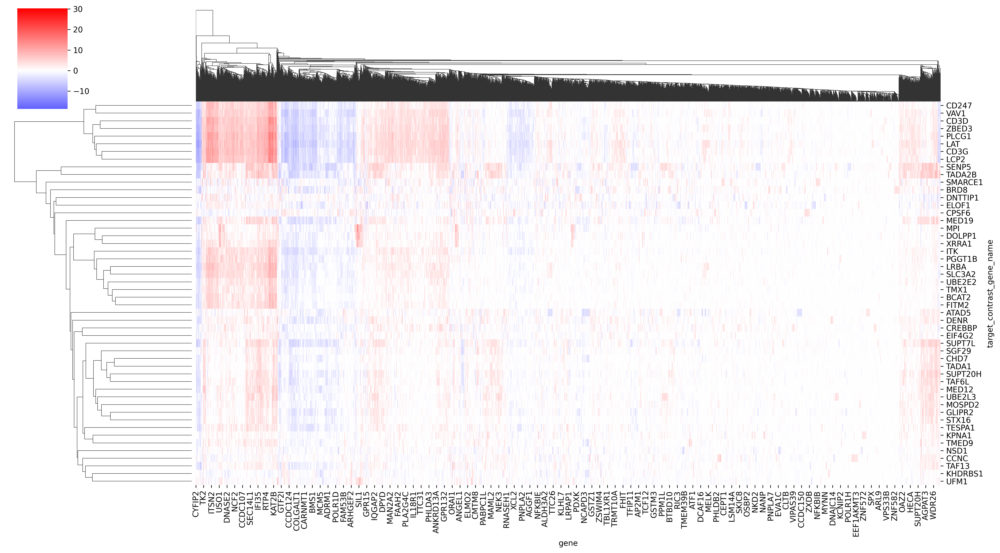

In [96]:
targets_oi = de_counts[de_counts.condition == 'Stim8hr'].sort_values('n_total_de_genes', ascending=False)[0:50].target_name.tolist()

targets = targets_oi 
genes = None
cond = 'Stim8hr'
effect_stat = 'zscore'
signif_stat = 'adj_p_value'
signif_alpha = 0.1
filter_signif = True
mask_targets = True

res_df = get_DE_results_long(
    adata_de, 
    targets=targets, genes=genes,
    effect_estimates=[effect_stat], signif_alpha=signif_alpha, signif_estimate=signif_stat)
res_df = res_df[res_df['culture_condition'] == cond]

if mask_targets:
    res_df.loc[res_df['target_contrast_gene_name'] == res_df['gene'], effect_stat] = 0
    res_df.loc[res_df['target_contrast_gene_name'] == res_df['gene'], 'significant'] = False

if filter_signif:
    res_df = res_df[res_df['significant']]
else:
    keep_genes = res_df.gene[res_df['significant']].unique()
    keep_targets = res_df.target_contrast_gene_name[res_df['significant']].unique()
    res_df = res_df[res_df.gene.isin(keep_genes) & res_df.target_contrast_gene_name.isin(keep_targets)]

pl_df = res_df.pivot(columns='target_contrast_gene_name', index='gene', values=effect_stat)

sns.clustermap(pl_df.T.fillna(0), cmap='bwr', center=0, yticklabels=True, figsize=(18,10))

## Shared effects between perturbations

In [22]:
# Restict to perturbations with at least 2 significant DE genes
targets = de_counts[(de_counts.condition == 'Stim8hr') & (de_counts.n_total_de_genes > 1)].target_name.tolist()
genes = None
cond = 'Stim8hr'
effect_stat = 'zscore'
signif_stat = 'adj_p_value'
signif_alpha = 0.05
filter_signif = True
mask_targets = True

res_df = get_DE_results_long(
    adata_de, 
    targets=targets, genes=genes,
    effect_estimates=[effect_stat], signif_alpha=signif_alpha, signif_estimate=signif_stat)
res_df = res_df[res_df['culture_condition'] == cond]

if mask_targets:
    res_df.loc[res_df['target_contrast_gene_name'] == res_df['gene'], effect_stat] = 0
    res_df.loc[res_df['target_contrast_gene_name'] == res_df['gene'], 'significant'] = False

if filter_signif:
    res_df = res_df[res_df['significant']]
else:
    keep_genes = res_df.gene[res_df['significant']].unique()
    keep_targets = res_df.target_contrast_gene_name[res_df['significant']].unique()
    res_df = res_df[res_df.gene.isin(keep_genes) & res_df.target_contrast_gene_name.isin(keep_targets)]



In [23]:
trans_effects_df = res_df.pivot(columns='target_contrast_gene_name', index='gene', values=effect_stat)
trans_effects_df = np.sign(trans_effects_df).fillna(0)
trans_effects_df = trans_effects_df.loc[:, np.abs(trans_effects_df).sum(0) > 1]
trans_effects_df = trans_effects_df[trans_effects_df.sum(1) != 0]
trans_effects_df

target_contrast_gene_name,TARS2,HDAC3,PGK1,NCBP3,UFM1,SIN3B,CALHM6,PKM,RNF138,ATP2A2,...,UCKL1,TK2,FAN1,GJB6,CCNI2,GPANK1,ZNF302,MDP1,TNF,SMIM10L1
gene,,,,,,,,,,,,,,,,,,,,,
ENSG00000000419,1.0,1.0,-1.0,-1.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENSG00000000460,1.0,0.0,0.0,0.0,-1.0,0.0,0.0,0.0,0.0,-1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENSG00000000971,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENSG00000001036,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENSG00000001167,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000285077,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENSG00000288722,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENSG00000290292,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Compute Jaccard similarity between perturbations 

In [24]:
# Compute intersection
pos_trans_effects_df = trans_effects_df.copy()
pos_trans_effects_df[pos_trans_effects_df < 0] = 0
neg_trans_effects_df = trans_effects_df.copy()
neg_trans_effects_df[neg_trans_effects_df > 0] = 0
shared_effects = pos_trans_effects_df.T.dot(pos_trans_effects_df) + neg_trans_effects_df.T.dot(neg_trans_effects_df)

# Compute size of union
n = shared_effects.shape[0]
total_genes = np.diag(shared_effects)
total_i = np.tile(total_genes.reshape(-1, 1), (1, n))
total_j = np.tile(total_genes.reshape(1, -1), (n, 1))
union = total_i + total_j - shared_effects

# Jaccard index (intersection / union)
similarity = np.divide(shared_effects.values, union, 
                            out=np.zeros_like(shared_effects, dtype=float), 
                            where=union!=0)

In [25]:
from scipy import cluster
# Filter by fraction of shared effects
filtered_data = similarity.loc[shared_effects.sum(1) > 5, shared_effects.sum(1) > 5]
order_perts = filtered_data.sum(0).sort_values(ascending=False)[0:200].index.tolist()
ordered_data = filtered_data.loc[order_perts, order_perts]

# First generate clustermap to get ordering
clustermap = sns.clustermap(
    ordered_data,
    method='complete', metric='euclidean',
    figsize=(25,25), 
    xticklabels=True, yticklabels=True,
    cmap='magma'
)

# Get the row and column ordering from the clustermap
row_order = clustermap.dendrogram_row.reordered_ind
col_order = clustermap.dendrogram_col.reordered_ind
reordered_data = ordered_data.iloc[row_order, col_order]

/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


In [26]:
# Compute long format for shared effects
long_shared_effects = shared_effects.reset_index().melt(
    id_vars=['target_contrast_gene_name'], 
    value_name='n_shared_effects',
    var_name='target_contrast_gene_name_2'
).sort_values('n_shared_effects', ascending=False)

# Remove self-comparisons
long_shared_effects = long_shared_effects[
    long_shared_effects['target_contrast_gene_name'] != long_shared_effects['target_contrast_gene_name_2']
]

# Compute long format for Jaccard index
long_jaccard_index = filtered_data.reset_index().melt(
    id_vars=['target_contrast_gene_name'],
    value_name='jaccard_index', 
    var_name='target_contrast_gene_name_2'
).sort_values('jaccard_index', ascending=False)

# Remove self-comparisons
long_jaccard_index = long_jaccard_index[
    long_jaccard_index['target_contrast_gene_name'] != long_jaccard_index['target_contrast_gene_name_2']
]

# Merge shared effects with Jaccard index
long_jaccard_index = long_jaccard_index.merge(
    long_shared_effects,
    on=['target_contrast_gene_name', 'target_contrast_gene_name_2'],
    how='left'
)


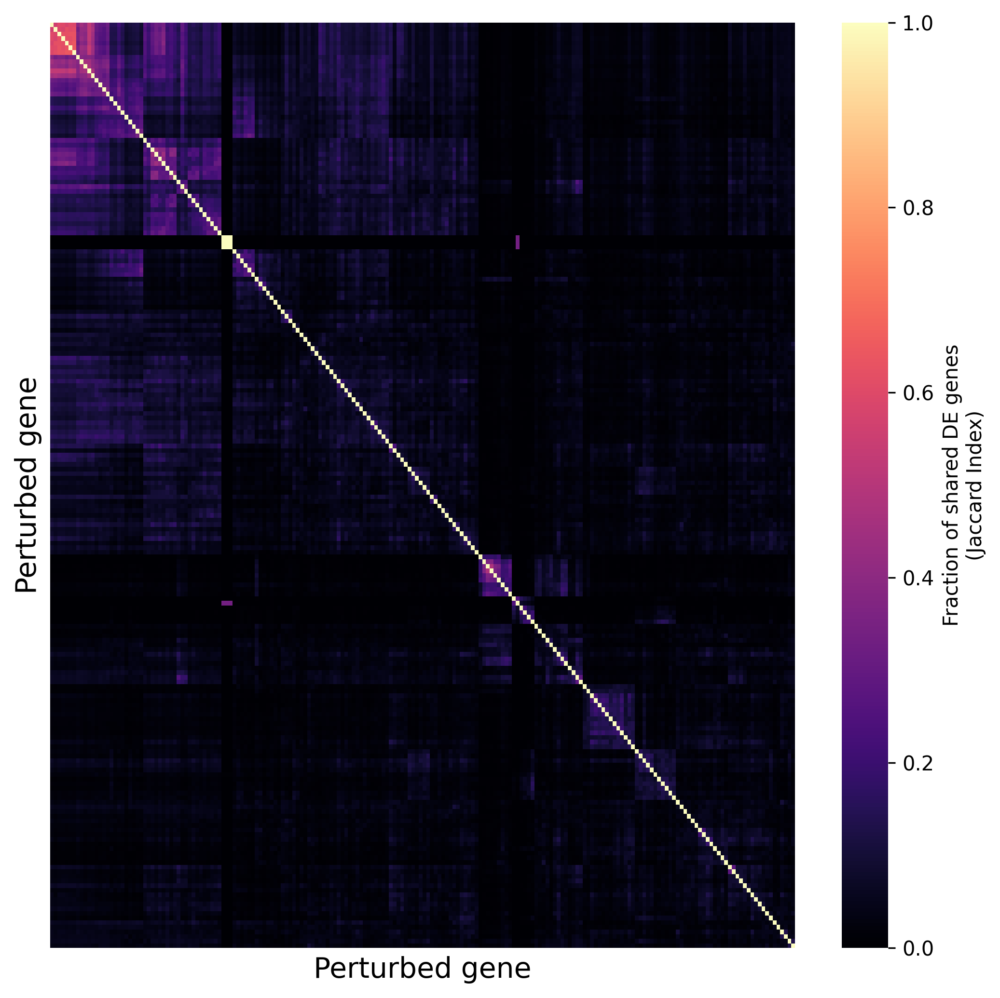

In [206]:

# Plot heatmap with the same ordering
plt.figure(figsize=(7,7))
sns.heatmap(
    reordered_data,
    cmap='magma',
    xticklabels=False,
    yticklabels=False,
    cbar_kws={'label': 'Fraction of shared DE genes\n(Jaccard Index)'}
)

plt.xlabel('Perturbed gene', fontsize=14)
plt.ylabel('Perturbed gene', fontsize=14)
plt.tight_layout()

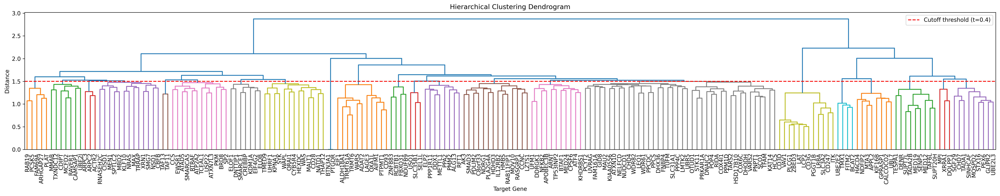

In [29]:
# Extract the clusters from the dendrogram
row_linkage = clustermap.dendrogram_row.linkage

# Plot the dendrogram separately to visualize the clustering

cutoff = 1.5
# Get the gene names for the filtered genes
filtered_genes = ordered_data.index.tolist()
# Create the dendrogram with gene names as labels
plt.figure(figsize=(25,5))
dendrogram = cluster.hierarchy.dendrogram(
    row_linkage, 
    color_threshold=cutoff,
    labels=filtered_genes
)
plt.axhline(y=cutoff, color='r', linestyle='--', label='Cutoff threshold (t=0.4)')
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Target Gene')
plt.ylabel('Distance')
plt.legend()
plt.xticks(rotation=90, fontsize=10)  # Rotate labels for better readability
plt.tight_layout()
plt.show()

# Apply clustering with the chosen cutoff
row_clusters = cluster.hierarchy.fcluster(row_linkage, t=cutoff, criterion='distance')

# Create a dictionary mapping cluster IDs to gene names
cluster_dict = {}
filtered_genes = ordered_data.loc[shared_effects.sum(1) > 5].index
for i, gene in enumerate(filtered_genes):
    cluster_id = row_clusters[i]
    if cluster_id not in cluster_dict:
        cluster_dict[cluster_id] = []
    cluster_dict[cluster_id].append(gene)

In [30]:
suspects = de_counts[de_counts['offtarget_flag']]['target_name'].unique().tolist()

In [31]:
# Create a list of tuples with (gene, cluster_id) pairs
cluster_assignments = []
for cluster_id, genes in cluster_dict.items():
    for gene in genes:
        cluster_assignments.append((gene, cluster_id))

# Convert to DataFrame
cluster_df = pd.DataFrame(cluster_assignments, columns=['target_gene', 'cluster_id'])

# Sort by cluster_id and then by gene name for better readability
cluster_df = cluster_df.sort_values(['cluster_id', 'target_gene'])

cluster_df

,target_gene,cluster_id
88,ARHGAP27,1
87,FAM69A,1
89,PCSK5,1
90,PLAT,1
86,RAB19,1
...,...,...
43,SGF29,22
44,SINHCAF,22
41,STX16,22
40,TADA1,22


Text(28.333333333333332, 0.5, 'Target gene')

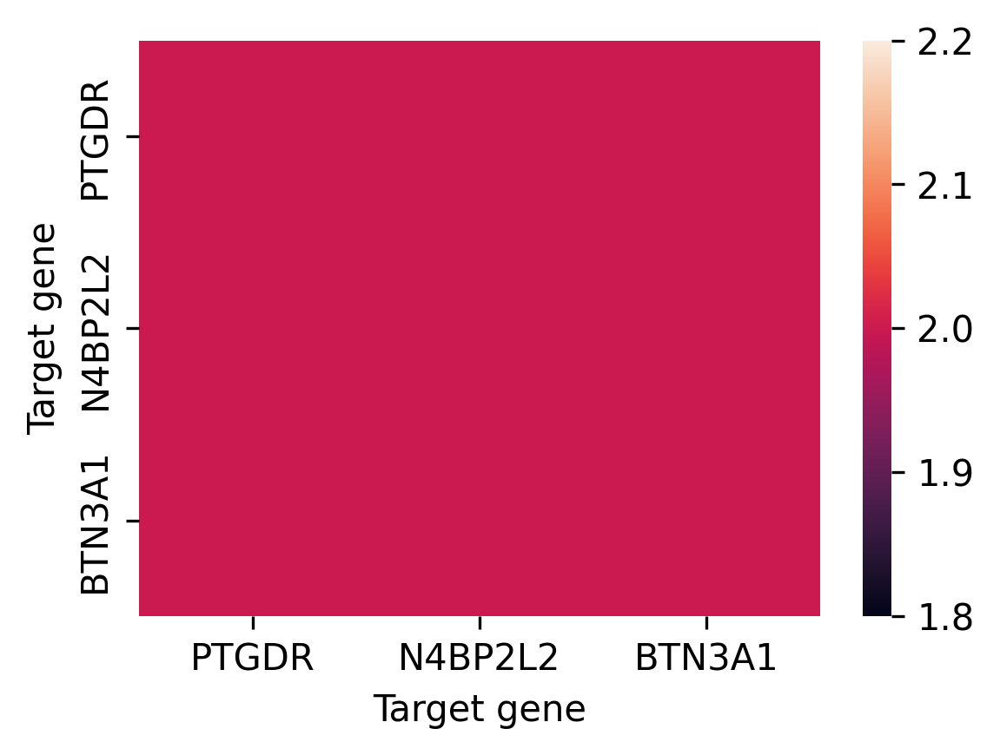

In [296]:
plt.figure(figsize = (4,3));
cl = 7
sns.heatmap(shared_effects.loc[cluster_dict[cl], cluster_dict[cl]], annot=False)
# Add proper axis labels to the main heatmap
plt.xlabel('Target gene')
plt.ylabel('Target gene')
# plt.title('N shared DE genes\n')

In [297]:
import gseapy as gp

def parse_gene_sets(filename):
   gene_sets = {}
   with open(filename, 'r') as f:
       for line in f:
           terms = line.strip().split('\t')
           gene_sets[terms[0]] = terms[2:]
   return gene_sets

OAKPATH = '/mnt/oak/'
# KEGG_sets = parse_gene_sets(f'{OAKPATH}/users/emma/data//KEGG_2019_Human.txt')
GO_BP_sets = parse_gene_sets(f'{OAKPATH}/users/emma/data/GO_Biological_Process_2023.txt')
GENESETS = {**GO_BP_sets}

# gl = cluster_dict[cl]
# background = adata_de.obs['target_contrast_gene_name'].unique().tolist()
background = shared_effects.index.tolist()

# # run enrichr
enr = gp.enrichr(gene_list=cluster_dict[cl],
                gene_sets=GENESETS,
                organism='Human', 
                background=background,
                outdir=None,
                no_plot=True
                )

enr.results[0:10]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Antigen Receptor-Mediated Signaling Pathway (G...,1/36,0.036057,0.064658,49.394366,164.120996,BTN3A1
1,gs_ind_0,Inflammatory Response (GO:0006954),1/38,0.038034,0.064658,46.728000,152.766813,PTGDR
2,gs_ind_0,Negative Regulation Of DNA-templated Transcrip...,1/238,0.222410,0.236311,6.872842,10.331484,N4BP2L2
3,gs_ind_0,Negative Regulation Of Hematopoietic Progenito...,1/4,0.004050,0.017206,506.485714,2790.256157,N4BP2L2
4,gs_ind_0,Negative Regulation Of Stem Cell Differentiati...,1/5,0.005061,0.017206,393.800000,2081.723915,N4BP2L2
5,gs_ind_0,Negative Regulation Of Transcription By RNA Po...,1/181,0.172512,0.209479,9.232687,16.224506,N4BP2L2
6,gs_ind_0,Positive Regulation Of Cytokine Production (GO...,1/74,0.073165,0.101968,23.546939,61.576231,BTN3A1
7,gs_ind_0,Positive Regulation Of Gene Expression (GO:001...,1/79,0.077975,0.101968,22.008917,56.152746,BTN3A1
8,gs_ind_0,Positive Regulation Of Multicellular Organisma...,1/76,0.075091,0.101968,22.907285,59.308226,BTN3A1
9,gs_ind_0,Positive Regulation Of Stem Cell Proliferation...,1/2,0.002026,0.017206,1182.600000,7333.921203,N4BP2L2


In [298]:
cluster_dict[cl]

['PTGDR', 'N4BP2L2', 'BTN3A1']

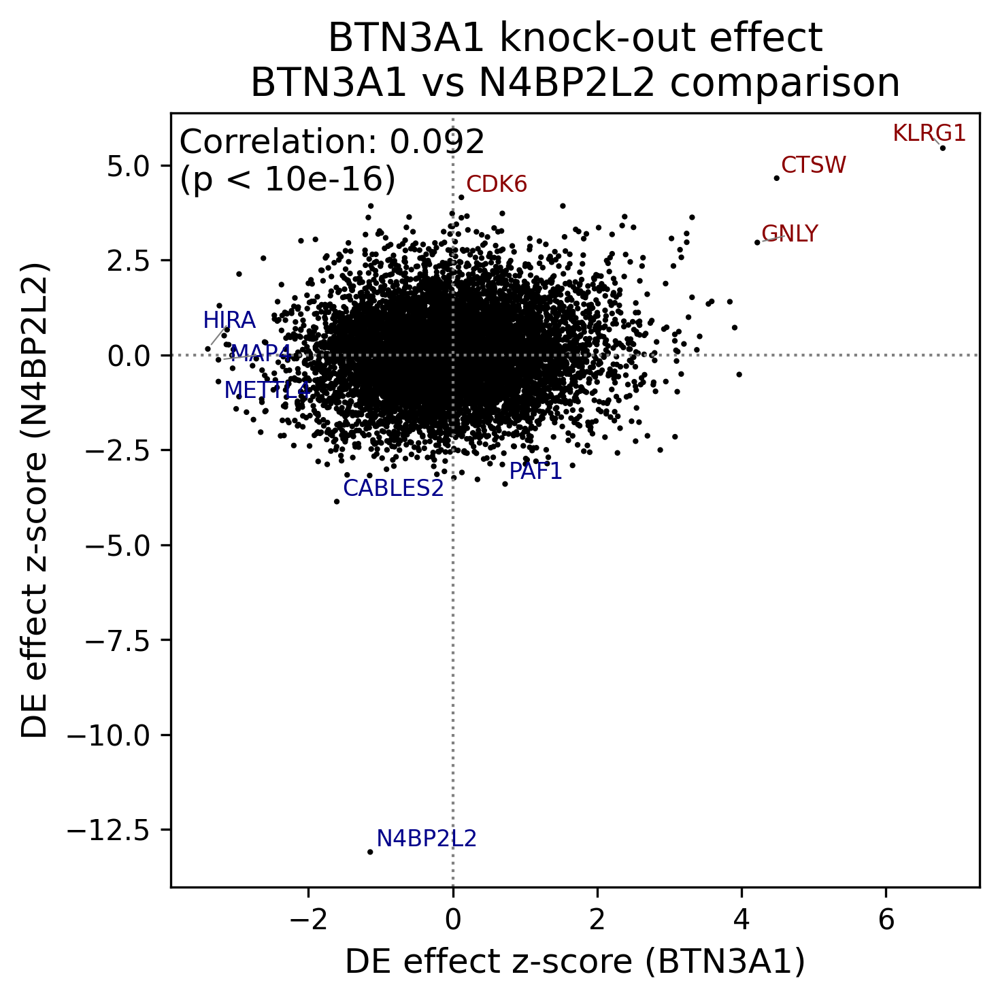

In [299]:
adata_de.var_names = adata_de.var['gene_name'].values

fig, axs = plt.subplots(figsize=(5,5))
res = plot_effect_comparison(
    adata_de, 
    comparison_params = {
        'target_contrast_gene_name':[ 'BTN3A1','N4BP2L2'],
        'culture_condition':['Stim8hr'],
        'stat':['zscore']
    },
    n_top_genes=3,
    plot_correlation=True,
    axis_label = 'DE effect z-score',
    corr_coords_xy = (0.01, 0.90),
    ax=axs
    )
    

In [42]:
# Compute long format for shared effects
long_shared_effects = shared_effects.reset_index().melt(
    id_vars=['target_contrast_gene_name'], 
    value_name='n_shared_effects',
    var_name='target_contrast_gene_name_2'
).sort_values('n_shared_effects', ascending=False)

# Remove self-comparisons
long_shared_effects = long_shared_effects[
    long_shared_effects['target_contrast_gene_name'] != long_shared_effects['target_contrast_gene_name_2']
]

# Compute long format for Jaccard index
long_jaccard_index = filtered_data.reset_index().melt(
    id_vars=['target_contrast_gene_name'],
    value_name='jaccard_index', 
    var_name='target_contrast_gene_name_2'
).sort_values('jaccard_index', ascending=False)

# Remove self-comparisons
long_jaccard_index = long_jaccard_index[
    long_jaccard_index['target_contrast_gene_name'] != long_jaccard_index['target_contrast_gene_name_2']
]

# Filter for at least some shared DE genes
long_jaccard_index = long_jaccard_index[long_jaccard_index.jaccard_index != 0].copy()

# Merge shared effects with Jaccard index
long_jaccard_index = long_jaccard_index.merge(
    long_shared_effects,
    on=['target_contrast_gene_name', 'target_contrast_gene_name_2'],
    how='left'
)

# Merge cluster information for both genes
long_jaccard_index = long_jaccard_index.merge(
    cluster_df.rename(columns={'target_gene': 'target_contrast_gene_name', 'cluster_id': 'cluster_id_1'}),
    on='target_contrast_gene_name',
    how='left'
).merge(
    cluster_df.rename(columns={'target_gene': 'target_contrast_gene_name_2', 'cluster_id': 'cluster_id_2'}),
    on='target_contrast_gene_name_2',
    how='left'
)

# Add column indicating if genes are in same cluster
long_jaccard_index['same_cluster'] = long_jaccard_index['cluster_id_1'] == long_jaccard_index['cluster_id_2']

# Keep only the first occurrence of each gene pair
long_jaccard_index['gene_pair'] = long_jaccard_index.apply(
    lambda x: tuple(sorted([x['target_contrast_gene_name'], x['target_contrast_gene_name_2']])), 
    axis=1
)

long_jaccard_index = long_jaccard_index.drop_duplicates(subset='gene_pair')
long_jaccard_index['gene_pair'] = long_jaccard_index['gene_pair'].apply(lambda x: ' - '.join(x))


In [46]:
print(datadir)

/mnt/oak/users/emma/data/GWT/CD4iR1_Psomagen/


In [ ]:
long_jaccard_index = long_jaccard_index.rename({
    'target_contrast_gene_name':'target_gene_name_1',
    'target_contrast_gene_name_2':'target_gene_name_2',
    'n_shared_effects':'n_shared_DE_genes'
}, axis=1).set_index('gene_pair')
long_jaccard_index.to_csv(f'{datadir}/DE_results_all_confounders/DE_shared_effects_jaccard.csv')

In [316]:
# Filter for positive jaccard index and sufficient shared effects
filtered_df = long_jaccard_index[(long_jaccard_index['jaccard_index'] > 0) & (long_jaccard_index['n_shared_effects'] > 2)]

# Create a sorted tuple of gene names for each row to identify duplicates
filtered_df['gene_pair'] = filtered_df.apply(
    lambda x: tuple(sorted([x['target_contrast_gene_name'], x['target_contrast_gene_name_2']])), 
    axis=1
)

# Keep only the first occurrence of each gene pair
shared_effects_long_df = filtered_df.drop_duplicates(subset='gene_pair')
# Convert gene_pair from tuple to string by joining with '_'
shared_effects_long_df['gene_pair'] = shared_effects_long_df['gene_pair'].apply(lambda x: ' - '.join(x))


/tmp/ipykernel_2882031/3013899316.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['gene_pair'] = filtered_df.apply(
/tmp/ipykernel_2882031/3013899316.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shared_effects_long_df['gene_pair'] = shared_effects_long_df['gene_pair'].apply(lambda x: ' - '.join(x))


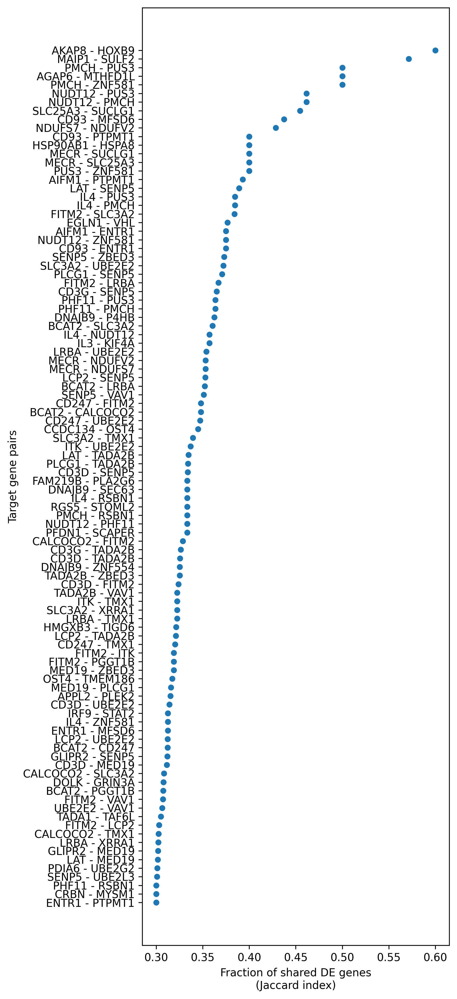

In [324]:
# sns.stripplot(data=shared_effects_long_df[shared_effects_long_df['same_cluster']], y='cluster_id_1', x='jaccard_index');
plt.figure(figsize=(6, 13))
sns.scatterplot(data=shared_effects_long_df[~shared_effects_long_df['same_cluster']][0:100], y='gene_pair', x='jaccard_index');
plt.xlabel('Fraction of shared DE genes\n(Jaccard index)')
plt.ylabel('Target gene pairs')
plt.tight_layout()